# Session (466029_f3_stage2_day2)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day2" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day2"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35581, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


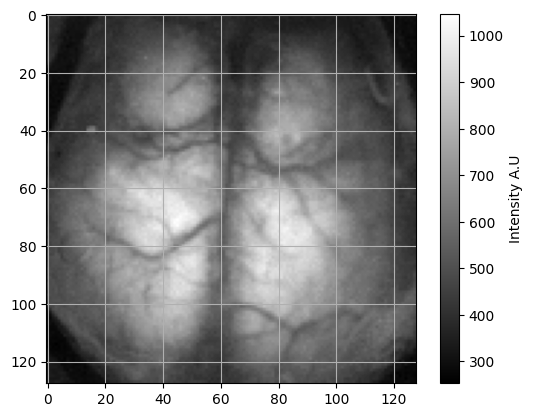

frame number 6000 plotted


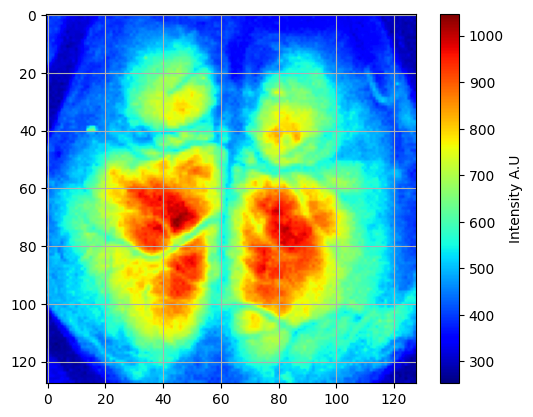

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 288.652880859375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 324.7344909667969


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 100
Number of double_flash pairs: 50
Number of single_flash: 33
Number of total flashes: 133


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/133 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/133 [00:01<03:02,  1.38s/it]

  2%|█▏                                                                                | 2/133 [00:02<03:02,  1.39s/it]

  2%|█▊                                                                                | 3/133 [00:04<02:59,  1.38s/it]

  3%|██▍                                                                               | 4/133 [00:05<02:50,  1.32s/it]

  4%|███                                                                               | 5/133 [00:06<02:48,  1.31s/it]

  5%|███▋                                                                              | 6/133 [00:08<02:47,  1.32s/it]

  5%|████▎                                                                             | 7/133 [00:09<02:46,  1.32s/it]

  6%|████▉                                                                             | 8/133 [00:10<02:51,  1.37s/it]

  7%|█████▌                                                                            | 9/133 [00:12<02:52,  1.39s/it]

  8%|██████                                                                           | 10/133 [00:13<02:50,  1.38s/it]

  8%|██████▋                                                                          | 11/133 [00:15<02:52,  1.41s/it]

  9%|███████▎                                                                         | 12/133 [00:16<02:52,  1.42s/it]

 10%|███████▉                                                                         | 13/133 [00:17<02:48,  1.41s/it]

 11%|████████▌                                                                        | 14/133 [00:19<02:48,  1.41s/it]

 11%|█████████▏                                                                       | 15/133 [00:20<02:50,  1.44s/it]

 12%|█████████▋                                                                       | 16/133 [00:22<02:46,  1.42s/it]

 13%|██████████▎                                                                      | 17/133 [00:23<02:49,  1.46s/it]

 14%|██████████▉                                                                      | 18/133 [00:25<02:50,  1.48s/it]

 14%|███████████▌                                                                     | 19/133 [00:26<02:45,  1.45s/it]

 15%|████████████▏                                                                    | 20/133 [00:28<02:47,  1.48s/it]

 16%|████████████▊                                                                    | 21/133 [00:29<02:44,  1.47s/it]

 17%|█████████████▍                                                                   | 22/133 [00:31<02:40,  1.44s/it]

 17%|██████████████                                                                   | 23/133 [00:32<02:31,  1.38s/it]

 18%|██████████████▌                                                                  | 24/133 [00:33<02:28,  1.36s/it]

 19%|███████████████▏                                                                 | 25/133 [00:34<02:21,  1.31s/it]

 20%|███████████████▊                                                                 | 26/133 [00:36<02:19,  1.31s/it]

 20%|████████████████▍                                                                | 27/133 [00:37<02:21,  1.34s/it]

 21%|█████████████████                                                                | 28/133 [00:38<02:23,  1.37s/it]

 22%|█████████████████▋                                                               | 29/133 [00:40<02:26,  1.40s/it]

 23%|██████████████████▎                                                              | 30/133 [00:41<02:23,  1.39s/it]

 23%|██████████████████▉                                                              | 31/133 [00:43<02:23,  1.40s/it]

 24%|███████████████████▍                                                             | 32/133 [00:44<02:24,  1.43s/it]

 25%|████████████████████                                                             | 33/133 [00:46<02:26,  1.47s/it]

 26%|████████████████████▋                                                            | 34/133 [00:47<02:24,  1.46s/it]

 26%|█████████████████████▎                                                           | 35/133 [00:49<02:21,  1.45s/it]

 27%|█████████████████████▉                                                           | 36/133 [00:50<02:22,  1.47s/it]

 28%|██████████████████████▌                                                          | 37/133 [00:52<02:18,  1.45s/it]

 29%|███████████████████████▏                                                         | 38/133 [00:53<02:13,  1.41s/it]

 29%|███████████████████████▊                                                         | 39/133 [00:54<02:15,  1.44s/it]

 30%|████████████████████████▎                                                        | 40/133 [00:56<02:13,  1.43s/it]

 31%|████████████████████████▉                                                        | 41/133 [00:57<02:05,  1.37s/it]

 32%|█████████████████████████▌                                                       | 42/133 [00:58<02:04,  1.36s/it]

 32%|██████████████████████████▏                                                      | 43/133 [01:00<02:05,  1.39s/it]

 33%|██████████████████████████▊                                                      | 44/133 [01:01<02:04,  1.40s/it]

 34%|███████████████████████████▍                                                     | 45/133 [01:03<02:03,  1.40s/it]

 35%|████████████████████████████                                                     | 46/133 [01:04<02:01,  1.39s/it]

 35%|████████████████████████████▌                                                    | 47/133 [01:05<02:00,  1.40s/it]

 36%|█████████████████████████████▏                                                   | 48/133 [01:07<01:57,  1.38s/it]

 37%|█████████████████████████████▊                                                   | 49/133 [01:08<01:57,  1.40s/it]

 38%|██████████████████████████████▍                                                  | 50/133 [01:10<01:57,  1.42s/it]

 38%|███████████████████████████████                                                  | 51/133 [01:11<01:58,  1.44s/it]

 39%|███████████████████████████████▋                                                 | 52/133 [01:13<01:55,  1.42s/it]

 40%|████████████████████████████████▎                                                | 53/133 [01:14<01:50,  1.38s/it]

 41%|████████████████████████████████▉                                                | 54/133 [01:15<01:47,  1.36s/it]

 41%|█████████████████████████████████▍                                               | 55/133 [01:17<01:49,  1.40s/it]

 42%|██████████████████████████████████                                               | 56/133 [01:18<01:49,  1.42s/it]

 43%|██████████████████████████████████▋                                              | 57/133 [01:19<01:45,  1.39s/it]

 44%|███████████████████████████████████▎                                             | 58/133 [01:21<01:42,  1.37s/it]

 44%|███████████████████████████████████▉                                             | 59/133 [01:22<01:39,  1.34s/it]

 45%|████████████████████████████████████▌                                            | 60/133 [01:23<01:36,  1.32s/it]

 46%|█████████████████████████████████████▏                                           | 61/133 [01:25<01:36,  1.35s/it]

 47%|█████████████████████████████████████▊                                           | 62/133 [01:26<01:38,  1.38s/it]

 47%|██████████████████████████████████████▎                                          | 63/133 [01:28<01:40,  1.43s/it]

 48%|██████████████████████████████████████▉                                          | 64/133 [01:29<01:43,  1.50s/it]

 49%|███████████████████████████████████████▌                                         | 65/133 [01:31<01:39,  1.46s/it]

 50%|████████████████████████████████████████▏                                        | 66/133 [01:32<01:36,  1.45s/it]

 50%|████████████████████████████████████████▊                                        | 67/133 [01:34<01:33,  1.42s/it]

 51%|█████████████████████████████████████████▍                                       | 68/133 [01:35<01:32,  1.42s/it]

 52%|██████████████████████████████████████████                                       | 69/133 [01:36<01:30,  1.41s/it]

 53%|██████████████████████████████████████████▋                                      | 70/133 [01:38<01:27,  1.39s/it]

 53%|███████████████████████████████████████████▏                                     | 71/133 [01:39<01:25,  1.38s/it]

 54%|███████████████████████████████████████████▊                                     | 72/133 [01:40<01:25,  1.40s/it]

 55%|████████████████████████████████████████████▍                                    | 73/133 [01:42<01:25,  1.43s/it]

 56%|█████████████████████████████████████████████                                    | 74/133 [01:43<01:23,  1.42s/it]

 56%|█████████████████████████████████████████████▋                                   | 75/133 [01:45<01:20,  1.39s/it]

 57%|██████████████████████████████████████████████▎                                  | 76/133 [01:46<01:19,  1.39s/it]

 58%|██████████████████████████████████████████████▉                                  | 77/133 [01:47<01:16,  1.37s/it]

 59%|███████████████████████████████████████████████▌                                 | 78/133 [01:49<01:14,  1.36s/it]

 59%|████████████████████████████████████████████████                                 | 79/133 [01:50<01:12,  1.35s/it]

 60%|████████████████████████████████████████████████▋                                | 80/133 [01:51<01:11,  1.35s/it]

 61%|█████████████████████████████████████████████████▎                               | 81/133 [01:53<01:10,  1.36s/it]

 62%|█████████████████████████████████████████████████▉                               | 82/133 [01:54<01:09,  1.37s/it]

 62%|██████████████████████████████████████████████████▌                              | 83/133 [01:55<01:07,  1.35s/it]

 63%|███████████████████████████████████████████████████▏                             | 84/133 [01:57<01:06,  1.37s/it]

 64%|███████████████████████████████████████████████████▊                             | 85/133 [01:58<01:05,  1.37s/it]

 65%|████████████████████████████████████████████████████▍                            | 86/133 [02:00<01:04,  1.38s/it]

 65%|████████████████████████████████████████████████████▉                            | 87/133 [02:01<01:03,  1.38s/it]

 66%|█████████████████████████████████████████████████████▌                           | 88/133 [02:02<01:02,  1.38s/it]

 67%|██████████████████████████████████████████████████████▏                          | 89/133 [02:04<01:00,  1.37s/it]

 68%|██████████████████████████████████████████████████████▊                          | 90/133 [02:05<01:01,  1.42s/it]

 68%|███████████████████████████████████████████████████████▍                         | 91/133 [02:07<01:00,  1.44s/it]

 69%|████████████████████████████████████████████████████████                         | 92/133 [02:08<00:58,  1.43s/it]

 70%|████████████████████████████████████████████████████████▋                        | 93/133 [02:10<00:56,  1.40s/it]

 71%|█████████████████████████████████████████████████████████▏                       | 94/133 [02:11<00:55,  1.43s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 95/133 [02:13<00:54,  1.44s/it]

 72%|██████████████████████████████████████████████████████████▍                      | 96/133 [02:14<00:53,  1.45s/it]

 73%|███████████████████████████████████████████████████████████                      | 97/133 [02:15<00:52,  1.45s/it]

 74%|███████████████████████████████████████████████████████████▋                     | 98/133 [02:17<00:50,  1.44s/it]

 74%|████████████████████████████████████████████████████████████▎                    | 99/133 [02:18<00:49,  1.46s/it]

 75%|████████████████████████████████████████████████████████████▏                   | 100/133 [02:20<00:50,  1.53s/it]

 76%|████████████████████████████████████████████████████████████▊                   | 101/133 [02:22<00:48,  1.53s/it]

 77%|█████████████████████████████████████████████████████████████▎                  | 102/133 [02:23<00:47,  1.53s/it]

 77%|█████████████████████████████████████████████████████████████▉                  | 103/133 [02:25<00:46,  1.55s/it]

 78%|██████████████████████████████████████████████████████████████▌                 | 104/133 [02:26<00:44,  1.52s/it]

 79%|███████████████████████████████████████████████████████████████▏                | 105/133 [02:28<00:42,  1.53s/it]

 80%|███████████████████████████████████████████████████████████████▊                | 106/133 [02:29<00:41,  1.55s/it]

 80%|████████████████████████████████████████████████████████████████▎               | 107/133 [02:31<00:40,  1.55s/it]

 81%|████████████████████████████████████████████████████████████████▉               | 108/133 [02:32<00:38,  1.55s/it]

 82%|█████████████████████████████████████████████████████████████████▌              | 109/133 [02:34<00:37,  1.54s/it]

 83%|██████████████████████████████████████████████████████████████████▏             | 110/133 [02:36<00:36,  1.60s/it]

 83%|██████████████████████████████████████████████████████████████████▊             | 111/133 [02:37<00:34,  1.59s/it]

 84%|███████████████████████████████████████████████████████████████████▎            | 112/133 [02:39<00:33,  1.60s/it]

 85%|███████████████████████████████████████████████████████████████████▉            | 113/133 [02:41<00:32,  1.63s/it]

 86%|████████████████████████████████████████████████████████████████████▌           | 114/133 [02:42<00:31,  1.64s/it]

 86%|█████████████████████████████████████████████████████████████████████▏          | 115/133 [02:44<00:29,  1.65s/it]

 87%|█████████████████████████████████████████████████████████████████████▊          | 116/133 [02:46<00:28,  1.67s/it]

 88%|██████████████████████████████████████████████████████████████████████▍         | 117/133 [02:47<00:26,  1.66s/it]

 89%|██████████████████████████████████████████████████████████████████████▉         | 118/133 [02:49<00:24,  1.63s/it]

 89%|███████████████████████████████████████████████████████████████████████▌        | 119/133 [02:50<00:22,  1.61s/it]

 90%|████████████████████████████████████████████████████████████████████████▏       | 120/133 [02:52<00:20,  1.61s/it]

 91%|████████████████████████████████████████████████████████████████████████▊       | 121/133 [02:54<00:19,  1.66s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 122/133 [02:55<00:17,  1.61s/it]

 92%|█████████████████████████████████████████████████████████████████████████▉      | 123/133 [02:57<00:15,  1.58s/it]

 93%|██████████████████████████████████████████████████████████████████████████▌     | 124/133 [02:58<00:13,  1.51s/it]

 94%|███████████████████████████████████████████████████████████████████████████▏    | 125/133 [03:00<00:12,  1.50s/it]

 95%|███████████████████████████████████████████████████████████████████████████▊    | 126/133 [03:01<00:10,  1.47s/it]

 95%|████████████████████████████████████████████████████████████████████████████▍   | 127/133 [03:02<00:08,  1.44s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 128/133 [03:04<00:06,  1.40s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 129/133 [03:05<00:05,  1.41s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 130/133 [03:07<00:04,  1.49s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 131/133 [03:08<00:02,  1.47s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 132/133 [03:10<00:01,  1.47s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 133/133 [03:11<00:00,  1.45s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 133/133 [03:11<00:00,  1.44s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 21%|████████████████▉                                                               | 27/128 [00:00<00:00, 264.79it/s]

 42%|█████████████████████████████████▊                                              | 54/128 [00:00<00:00, 245.01it/s]

 63%|██████████████████████████████████████████████████▋                             | 81/128 [00:00<00:00, 254.76it/s]

 84%|██████████████████████████████████████████████████████████████████             | 107/128 [00:00<00:00, 248.28it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 225.43it/s]

  0%|                                                                                        | 0/34870 [00:00<?, ?it/s]

  0%|                                                                              | 20/34870 [00:00<02:59, 194.25it/s]

  0%|                                                                              | 48/34870 [00:00<02:25, 239.95it/s]

  0%|▏                                                                             | 73/34870 [00:00<02:23, 242.32it/s]

  0%|▏                                                                             | 98/34870 [00:00<02:29, 232.68it/s]

  0%|▎                                                                            | 123/34870 [00:00<02:29, 233.06it/s]

  0%|▎                                                                            | 147/34870 [00:00<02:29, 232.32it/s]

  0%|▍                                                                            | 171/34870 [00:00<02:39, 217.03it/s]

  1%|▍                                                                            | 194/34870 [00:00<02:39, 217.66it/s]

  1%|▍                                                                            | 219/34870 [00:00<02:34, 223.87it/s]

  1%|▌                                                                            | 242/34870 [00:01<02:38, 218.67it/s]

  1%|▌                                                                            | 265/34870 [00:01<02:36, 221.31it/s]

  1%|▋                                                                            | 289/34870 [00:01<02:34, 224.16it/s]

  1%|▋                                                                            | 319/34870 [00:01<02:21, 244.12it/s]

  1%|▊                                                                            | 344/34870 [00:01<02:22, 242.33it/s]

  1%|▊                                                                            | 369/34870 [00:01<02:21, 243.17it/s]

  1%|▉                                                                            | 399/34870 [00:01<02:13, 257.57it/s]

  1%|▉                                                                            | 425/34870 [00:01<02:15, 253.47it/s]

  1%|▉                                                                            | 451/34870 [00:01<02:26, 234.65it/s]

  1%|█                                                                            | 476/34870 [00:02<02:25, 237.11it/s]

  1%|█                                                                            | 501/34870 [00:02<02:23, 239.46it/s]

  2%|█▏                                                                           | 527/34870 [00:02<02:20, 244.06it/s]

  2%|█▏                                                                           | 553/34870 [00:02<02:18, 247.26it/s]

  2%|█▎                                                                           | 580/34870 [00:02<02:15, 252.43it/s]

  2%|█▎                                                                           | 607/34870 [00:02<02:14, 254.62it/s]

  2%|█▍                                                                           | 636/34870 [00:02<02:10, 262.68it/s]

  2%|█▍                                                                           | 665/34870 [00:02<02:07, 267.57it/s]

  2%|█▌                                                                           | 693/34870 [00:02<02:06, 269.66it/s]

  2%|█▌                                                                           | 720/34870 [00:02<02:10, 262.09it/s]

  2%|█▋                                                                           | 749/34870 [00:03<02:07, 267.87it/s]

  2%|█▋                                                                           | 777/34870 [00:03<02:05, 270.62it/s]

  2%|█▊                                                                           | 805/34870 [00:03<02:19, 244.73it/s]

  2%|█▊                                                                           | 833/34870 [00:03<02:14, 252.30it/s]

  2%|█▉                                                                           | 859/34870 [00:03<02:18, 244.92it/s]

  3%|█▉                                                                           | 884/34870 [00:03<02:21, 239.72it/s]

  3%|██                                                                           | 912/34870 [00:03<02:15, 249.89it/s]

  3%|██                                                                           | 938/34870 [00:03<02:15, 250.65it/s]

  3%|██▏                                                                          | 967/34870 [00:03<02:09, 261.20it/s]

  3%|██▏                                                                          | 997/34870 [00:04<02:05, 270.13it/s]

  3%|██▏                                                                         | 1025/34870 [00:04<02:05, 269.11it/s]

  3%|██▎                                                                         | 1052/34870 [00:04<02:11, 258.14it/s]

  3%|██▎                                                                         | 1078/34870 [00:04<02:16, 248.10it/s]

  3%|██▍                                                                         | 1103/34870 [00:04<02:23, 235.45it/s]

  3%|██▍                                                                         | 1130/34870 [00:04<02:18, 242.97it/s]

  3%|██▌                                                                         | 1159/34870 [00:04<02:12, 254.05it/s]

  3%|██▌                                                                         | 1187/34870 [00:04<02:09, 260.72it/s]

  3%|██▋                                                                         | 1214/34870 [00:04<02:11, 256.76it/s]

  4%|██▋                                                                         | 1240/34870 [00:05<02:19, 240.76it/s]

  4%|██▊                                                                         | 1265/34870 [00:05<02:24, 233.21it/s]

  4%|██▊                                                                         | 1290/34870 [00:05<02:22, 235.26it/s]

  4%|██▊                                                                         | 1314/34870 [00:05<02:27, 227.70it/s]

  4%|██▉                                                                         | 1337/34870 [00:05<02:28, 225.85it/s]

  4%|██▉                                                                         | 1364/34870 [00:05<02:21, 236.32it/s]

  4%|███                                                                         | 1394/34870 [00:05<02:13, 251.64it/s]

  4%|███                                                                         | 1420/34870 [00:05<02:12, 252.62it/s]

  4%|███▏                                                                        | 1446/34870 [00:05<02:23, 232.55it/s]

  4%|███▏                                                                        | 1471/34870 [00:06<02:21, 236.06it/s]

  4%|███▎                                                                        | 1498/34870 [00:06<02:16, 244.23it/s]

  4%|███▎                                                                        | 1525/34870 [00:06<02:13, 250.17it/s]

  4%|███▍                                                                        | 1551/34870 [00:06<02:13, 248.73it/s]

  5%|███▍                                                                        | 1580/34870 [00:06<02:08, 259.90it/s]

  5%|███▌                                                                        | 1608/34870 [00:06<02:05, 265.00it/s]

  5%|███▌                                                                        | 1635/34870 [00:06<02:12, 251.05it/s]

  5%|███▌                                                                        | 1661/34870 [00:06<02:17, 240.67it/s]

  5%|███▋                                                                        | 1686/34870 [00:06<02:17, 241.94it/s]

  5%|███▋                                                                        | 1714/34870 [00:06<02:12, 250.60it/s]

  5%|███▊                                                                        | 1743/34870 [00:07<02:07, 259.28it/s]

  5%|███▊                                                                        | 1770/34870 [00:07<02:07, 260.15it/s]

  5%|███▉                                                                        | 1797/34870 [00:07<02:14, 245.27it/s]

  5%|███▉                                                                        | 1825/34870 [00:07<02:09, 254.26it/s]

  5%|████                                                                        | 1851/34870 [00:07<02:18, 237.69it/s]

  5%|████                                                                        | 1876/34870 [00:07<02:17, 239.12it/s]

  5%|████▏                                                                       | 1903/34870 [00:07<02:13, 246.40it/s]

  6%|████▏                                                                       | 1929/34870 [00:07<02:11, 249.58it/s]

  6%|████▎                                                                       | 1955/34870 [00:07<02:15, 242.47it/s]

  6%|████▎                                                                       | 1983/34870 [00:08<02:10, 251.28it/s]

  6%|████▍                                                                       | 2011/34870 [00:08<02:07, 258.06it/s]

  6%|████▍                                                                       | 2041/34870 [00:08<02:01, 269.44it/s]

  6%|████▌                                                                       | 2069/34870 [00:08<02:07, 256.81it/s]

  6%|████▌                                                                       | 2099/34870 [00:08<02:02, 266.77it/s]

  6%|████▋                                                                       | 2126/34870 [00:08<02:08, 254.63it/s]

  6%|████▋                                                                       | 2153/34870 [00:08<02:06, 258.23it/s]

  6%|████▊                                                                       | 2180/34870 [00:08<02:06, 258.66it/s]

  6%|████▊                                                                       | 2210/34870 [00:08<02:01, 268.24it/s]

  6%|████▉                                                                       | 2237/34870 [00:09<02:14, 242.19it/s]

  6%|████▉                                                                       | 2262/34870 [00:09<02:18, 236.01it/s]

  7%|████▉                                                                       | 2287/34870 [00:09<02:16, 238.54it/s]

  7%|█████                                                                       | 2312/34870 [00:09<02:19, 233.30it/s]

  7%|█████                                                                       | 2336/34870 [00:09<02:18, 234.54it/s]

  7%|█████▏                                                                      | 2360/34870 [00:09<02:25, 224.04it/s]

  7%|█████▏                                                                      | 2384/34870 [00:09<02:23, 226.61it/s]

  7%|█████▏                                                                      | 2407/34870 [00:09<02:29, 216.58it/s]

  7%|█████▎                                                                      | 2430/34870 [00:09<02:28, 218.51it/s]

  7%|█████▎                                                                      | 2457/34870 [00:10<02:20, 230.46it/s]

  7%|█████▍                                                                      | 2481/34870 [00:10<02:24, 224.26it/s]

  7%|█████▍                                                                      | 2509/34870 [00:10<02:15, 238.62it/s]

  7%|█████▌                                                                      | 2534/34870 [00:10<02:15, 237.82it/s]

  7%|█████▌                                                                      | 2562/34870 [00:10<02:09, 249.21it/s]

  7%|█████▋                                                                      | 2590/34870 [00:10<02:05, 256.67it/s]

  8%|█████▋                                                                      | 2616/34870 [00:10<02:07, 253.24it/s]

  8%|█████▊                                                                      | 2642/34870 [00:10<02:07, 253.75it/s]

  8%|█████▊                                                                      | 2672/34870 [00:10<02:01, 265.74it/s]

  8%|█████▉                                                                      | 2702/34870 [00:10<01:57, 273.41it/s]

  8%|█████▉                                                                      | 2730/34870 [00:11<02:03, 260.83it/s]

  8%|██████                                                                      | 2757/34870 [00:11<02:06, 254.07it/s]

  8%|██████                                                                      | 2783/34870 [00:11<02:10, 246.07it/s]

  8%|██████                                                                      | 2810/34870 [00:11<02:07, 251.37it/s]

  8%|██████▏                                                                     | 2837/34870 [00:11<02:05, 255.96it/s]

  8%|██████▏                                                                     | 2867/34870 [00:11<02:00, 265.61it/s]

  8%|██████▎                                                                     | 2897/34870 [00:11<01:57, 273.21it/s]

  8%|██████▍                                                                     | 2925/34870 [00:11<02:10, 244.65it/s]

  8%|██████▍                                                                     | 2951/34870 [00:11<02:10, 244.21it/s]

  9%|██████▍                                                                     | 2976/34870 [00:12<02:11, 242.49it/s]

  9%|██████▌                                                                     | 3001/34870 [00:12<02:11, 241.91it/s]

  9%|██████▌                                                                     | 3031/34870 [00:12<02:04, 255.47it/s]

  9%|██████▋                                                                     | 3060/34870 [00:12<02:00, 263.84it/s]

  9%|██████▋                                                                     | 3089/34870 [00:12<01:59, 266.80it/s]

  9%|██████▊                                                                     | 3116/34870 [00:12<02:03, 256.65it/s]

  9%|██████▊                                                                     | 3145/34870 [00:12<01:59, 265.37it/s]

  9%|██████▉                                                                     | 3172/34870 [00:12<02:15, 233.22it/s]

  9%|██████▉                                                                     | 3197/34870 [00:12<02:13, 237.05it/s]

  9%|███████                                                                     | 3226/34870 [00:13<02:06, 250.18it/s]

  9%|███████                                                                     | 3252/34870 [00:13<02:12, 238.92it/s]

  9%|███████▏                                                                    | 3277/34870 [00:13<02:16, 230.90it/s]

  9%|███████▏                                                                    | 3307/34870 [00:13<02:07, 248.37it/s]

 10%|███████▎                                                                    | 3333/34870 [00:13<02:18, 227.54it/s]

 10%|███████▎                                                                    | 3357/34870 [00:13<02:19, 226.66it/s]

 10%|███████▎                                                                    | 3381/34870 [00:13<02:18, 226.61it/s]

 10%|███████▍                                                                    | 3407/34870 [00:13<02:14, 234.55it/s]

 10%|███████▍                                                                    | 3432/34870 [00:13<02:12, 236.92it/s]

 10%|███████▌                                                                    | 3457/34870 [00:14<02:11, 239.06it/s]

 10%|███████▌                                                                    | 3483/34870 [00:14<02:09, 241.70it/s]

 10%|███████▋                                                                    | 3508/34870 [00:14<02:21, 221.73it/s]

 10%|███████▋                                                                    | 3537/34870 [00:14<02:11, 238.41it/s]

 10%|███████▊                                                                    | 3562/34870 [00:14<02:14, 233.22it/s]

 10%|███████▊                                                                    | 3587/34870 [00:14<02:12, 235.66it/s]

 10%|███████▊                                                                    | 3612/34870 [00:14<02:11, 237.71it/s]

 10%|███████▉                                                                    | 3636/34870 [00:14<02:16, 229.54it/s]

 10%|███████▉                                                                    | 3661/34870 [00:14<02:14, 232.71it/s]

 11%|████████                                                                    | 3685/34870 [00:15<02:15, 229.58it/s]

 11%|████████                                                                    | 3709/34870 [00:15<02:14, 231.91it/s]

 11%|████████▏                                                                   | 3736/34870 [00:15<02:08, 241.53it/s]

 11%|████████▏                                                                   | 3761/34870 [00:15<02:11, 235.79it/s]

 11%|████████▎                                                                   | 3789/34870 [00:15<02:05, 247.06it/s]

 11%|████████▎                                                                   | 3814/34870 [00:15<02:10, 237.63it/s]

 11%|████████▎                                                                   | 3838/34870 [00:15<02:18, 224.33it/s]

 11%|████████▍                                                                   | 3867/34870 [00:15<02:08, 241.16it/s]

 11%|████████▍                                                                   | 3892/34870 [00:15<02:07, 242.99it/s]

 11%|████████▌                                                                   | 3917/34870 [00:16<02:15, 228.04it/s]

 11%|████████▌                                                                   | 3941/34870 [00:16<02:21, 218.70it/s]

 11%|████████▋                                                                   | 3965/34870 [00:16<02:18, 223.29it/s]

 11%|████████▋                                                                   | 3989/34870 [00:16<02:16, 226.70it/s]

 12%|████████▊                                                                   | 4015/34870 [00:16<02:11, 234.83it/s]

 12%|████████▊                                                                   | 4045/34870 [00:16<02:02, 252.11it/s]

 12%|████████▉                                                                   | 4075/34870 [00:16<01:56, 264.48it/s]

 12%|████████▉                                                                   | 4103/34870 [00:16<01:55, 265.93it/s]

 12%|█████████                                                                   | 4132/34870 [00:16<01:53, 271.39it/s]

 12%|█████████                                                                   | 4160/34870 [00:16<01:56, 263.33it/s]

 12%|█████████▏                                                                  | 4187/34870 [00:17<02:02, 249.60it/s]

 12%|█████████▏                                                                  | 4213/34870 [00:17<02:09, 236.92it/s]

 12%|█████████▏                                                                  | 4237/34870 [00:17<02:13, 229.67it/s]

 12%|█████████▎                                                                  | 4261/34870 [00:17<02:15, 226.34it/s]

 12%|█████████▎                                                                  | 4287/34870 [00:17<02:11, 232.42it/s]

 12%|█████████▍                                                                  | 4312/34870 [00:17<02:09, 236.03it/s]

 12%|█████████▍                                                                  | 4339/34870 [00:17<02:05, 243.63it/s]

 13%|█████████▌                                                                  | 4367/34870 [00:17<02:00, 252.64it/s]

 13%|█████████▌                                                                  | 4397/34870 [00:17<01:55, 264.09it/s]

 13%|█████████▋                                                                  | 4424/34870 [00:18<02:02, 247.82it/s]

 13%|█████████▋                                                                  | 4450/34870 [00:18<02:04, 244.42it/s]

 13%|█████████▊                                                                  | 4477/34870 [00:18<02:02, 248.82it/s]

 13%|█████████▊                                                                  | 4504/34870 [00:18<01:59, 253.40it/s]

 13%|█████████▉                                                                  | 4532/34870 [00:18<01:56, 260.31it/s]

 13%|█████████▉                                                                  | 4559/34870 [00:18<02:03, 246.02it/s]

 13%|█████████▉                                                                  | 4584/34870 [00:18<02:05, 241.76it/s]

 13%|██████████                                                                  | 4609/34870 [00:18<02:14, 224.56it/s]

 13%|██████████                                                                  | 4639/34870 [00:18<02:04, 242.95it/s]

 13%|██████████▏                                                                 | 4664/34870 [00:19<02:09, 232.70it/s]

 13%|██████████▏                                                                 | 4688/34870 [00:19<02:09, 233.44it/s]

 14%|██████████▎                                                                 | 4716/34870 [00:19<02:03, 245.10it/s]

 14%|██████████▎                                                                 | 4743/34870 [00:19<01:59, 251.49it/s]

 14%|██████████▍                                                                 | 4770/34870 [00:19<01:58, 254.65it/s]

 14%|██████████▍                                                                 | 4797/34870 [00:19<01:56, 258.37it/s]

 14%|██████████▌                                                                 | 4827/34870 [00:19<01:51, 268.99it/s]

 14%|██████████▌                                                                 | 4854/34870 [00:19<01:52, 266.19it/s]

 14%|██████████▋                                                                 | 4884/34870 [00:19<01:48, 275.32it/s]

 14%|██████████▋                                                                 | 4913/34870 [00:20<01:48, 276.19it/s]

 14%|██████████▊                                                                 | 4942/34870 [00:20<01:46, 280.23it/s]

 14%|██████████▊                                                                 | 4972/34870 [00:20<01:45, 283.59it/s]

 14%|██████████▉                                                                 | 5003/34870 [00:20<01:43, 288.01it/s]

 14%|██████████▉                                                                 | 5032/34870 [00:20<01:44, 284.85it/s]

 15%|███████████                                                                 | 5061/34870 [00:20<01:44, 284.72it/s]

 15%|███████████                                                                 | 5090/34870 [00:20<01:51, 268.17it/s]

 15%|███████████▏                                                                | 5118/34870 [00:20<01:53, 261.93it/s]

 15%|███████████▏                                                                | 5145/34870 [00:20<01:53, 262.74it/s]

 15%|███████████▎                                                                | 5172/34870 [00:20<01:53, 262.59it/s]

 15%|███████████▎                                                                | 5199/34870 [00:21<01:58, 249.68it/s]

 15%|███████████▍                                                                | 5225/34870 [00:21<01:59, 249.11it/s]

 15%|███████████▍                                                                | 5251/34870 [00:21<02:03, 240.02it/s]

 15%|███████████▍                                                                | 5276/34870 [00:21<02:06, 234.36it/s]

 15%|███████████▌                                                                | 5301/34870 [00:21<02:05, 236.10it/s]

 15%|███████████▌                                                                | 5325/34870 [00:21<02:08, 229.48it/s]

 15%|███████████▋                                                                | 5349/34870 [00:21<02:11, 223.69it/s]

 15%|███████████▋                                                                | 5372/34870 [00:21<02:15, 218.19it/s]

 15%|███████████▊                                                                | 5399/34870 [00:21<02:07, 231.31it/s]

 16%|███████████▊                                                                | 5426/34870 [00:22<02:02, 240.91it/s]

 16%|███████████▉                                                                | 5451/34870 [00:22<02:04, 236.76it/s]

 16%|███████████▉                                                                | 5481/34870 [00:22<01:56, 253.35it/s]

 16%|████████████                                                                | 5507/34870 [00:22<02:00, 244.04it/s]

 16%|████████████                                                                | 5534/34870 [00:22<01:57, 249.29it/s]

 16%|████████████                                                                | 5560/34870 [00:22<01:58, 247.42it/s]

 16%|████████████▏                                                               | 5587/34870 [00:22<01:55, 252.46it/s]

 16%|████████████▏                                                               | 5613/34870 [00:22<02:02, 238.80it/s]

 16%|████████████▎                                                               | 5638/34870 [00:22<02:01, 240.61it/s]

 16%|████████████▎                                                               | 5663/34870 [00:23<02:05, 233.29it/s]

 16%|████████████▍                                                               | 5687/34870 [00:23<02:07, 229.41it/s]

 16%|████████████▍                                                               | 5714/34870 [00:23<02:03, 236.74it/s]

 16%|████████████▌                                                               | 5740/34870 [00:23<01:59, 242.93it/s]

 17%|████████████▌                                                               | 5765/34870 [00:23<02:06, 230.54it/s]

 17%|████████████▌                                                               | 5792/34870 [00:23<02:01, 238.90it/s]

 17%|████████████▋                                                               | 5820/34870 [00:23<01:57, 247.05it/s]

 17%|████████████▋                                                               | 5847/34870 [00:23<01:54, 252.89it/s]

 17%|████████████▊                                                               | 5873/34870 [00:23<01:58, 243.71it/s]

 17%|████████████▊                                                               | 5901/34870 [00:24<01:55, 251.86it/s]

 17%|████████████▉                                                               | 5928/34870 [00:24<01:53, 255.61it/s]

 17%|████████████▉                                                               | 5956/34870 [00:24<01:51, 259.68it/s]

 17%|█████████████                                                               | 5983/34870 [00:24<01:50, 261.19it/s]

 17%|█████████████                                                               | 6010/34870 [00:24<01:50, 261.50it/s]

 17%|█████████████▏                                                              | 6038/34870 [00:24<01:48, 265.38it/s]

 17%|█████████████▏                                                              | 6065/34870 [00:24<01:52, 256.96it/s]

 17%|█████████████▎                                                              | 6095/34870 [00:24<01:47, 267.83it/s]

 18%|█████████████▎                                                              | 6122/34870 [00:24<01:50, 260.19it/s]

 18%|█████████████▍                                                              | 6150/34870 [00:24<01:48, 264.37it/s]

 18%|█████████████▍                                                              | 6177/34870 [00:25<01:54, 251.48it/s]

 18%|█████████████▌                                                              | 6203/34870 [00:25<01:53, 252.48it/s]

 18%|█████████████▌                                                              | 6230/34870 [00:25<01:51, 256.77it/s]

 18%|█████████████▋                                                              | 6257/34870 [00:25<01:50, 259.12it/s]

 18%|█████████████▋                                                              | 6283/34870 [00:25<01:51, 257.16it/s]

 18%|█████████████▊                                                              | 6309/34870 [00:25<01:56, 244.46it/s]

 18%|█████████████▊                                                              | 6337/34870 [00:25<01:52, 253.12it/s]

 18%|█████████████▊                                                              | 6364/34870 [00:25<01:51, 255.06it/s]

 18%|█████████████▉                                                              | 6392/34870 [00:25<01:49, 260.03it/s]

 18%|█████████████▉                                                              | 6420/34870 [00:26<01:47, 265.08it/s]

 18%|██████████████                                                              | 6447/34870 [00:26<01:56, 244.40it/s]

 19%|██████████████                                                              | 6472/34870 [00:26<01:58, 239.56it/s]

 19%|██████████████▏                                                             | 6497/34870 [00:26<02:02, 230.93it/s]

 19%|██████████████▏                                                             | 6527/34870 [00:26<01:54, 247.87it/s]

 19%|██████████████▎                                                             | 6556/34870 [00:26<01:49, 259.61it/s]

 19%|██████████████▎                                                             | 6583/34870 [00:26<01:51, 253.99it/s]

 19%|██████████████▍                                                             | 6609/34870 [00:26<01:54, 247.32it/s]

 19%|██████████████▍                                                             | 6638/34870 [00:26<01:49, 258.61it/s]

 19%|██████████████▌                                                             | 6665/34870 [00:27<01:53, 248.40it/s]

 19%|██████████████▌                                                             | 6693/34870 [00:27<01:50, 255.11it/s]

 19%|██████████████▋                                                             | 6719/34870 [00:27<02:00, 233.37it/s]

 19%|██████████████▋                                                             | 6743/34870 [00:27<02:03, 227.23it/s]

 19%|██████████████▋                                                             | 6767/34870 [00:27<02:04, 225.22it/s]

 19%|██████████████▊                                                             | 6790/34870 [00:27<02:06, 222.28it/s]

 20%|██████████████▊                                                             | 6815/34870 [00:27<02:02, 228.10it/s]

 20%|██████████████▉                                                             | 6842/34870 [00:27<01:57, 238.61it/s]

 20%|██████████████▉                                                             | 6869/34870 [00:27<01:53, 246.91it/s]

 20%|███████████████                                                             | 6897/34870 [00:27<01:49, 255.05it/s]

 20%|███████████████                                                             | 6926/34870 [00:28<01:46, 262.97it/s]

 20%|███████████████▏                                                            | 6956/34870 [00:28<01:42, 272.23it/s]

 20%|███████████████▏                                                            | 6986/34870 [00:28<01:41, 275.55it/s]

 20%|███████████████▎                                                            | 7014/34870 [00:28<01:45, 264.53it/s]

 20%|███████████████▎                                                            | 7042/34870 [00:28<01:44, 266.69it/s]

 20%|███████████████▍                                                            | 7070/34870 [00:28<01:43, 268.23it/s]

 20%|███████████████▍                                                            | 7098/34870 [00:28<01:42, 270.10it/s]

 20%|███████████████▌                                                            | 7126/34870 [00:28<01:48, 255.87it/s]

 21%|███████████████▌                                                            | 7153/34870 [00:28<01:47, 258.77it/s]

 21%|███████████████▋                                                            | 7180/34870 [00:29<01:49, 253.22it/s]

 21%|███████████████▋                                                            | 7206/34870 [00:29<01:54, 241.58it/s]

 21%|███████████████▊                                                            | 7231/34870 [00:29<01:56, 236.57it/s]

 21%|███████████████▊                                                            | 7260/34870 [00:29<01:51, 248.64it/s]

 21%|███████████████▉                                                            | 7286/34870 [00:29<01:57, 234.70it/s]

 21%|███████████████▉                                                            | 7313/34870 [00:29<01:53, 243.68it/s]

 21%|███████████████▉                                                            | 7338/34870 [00:29<01:53, 243.43it/s]

 21%|████████████████                                                            | 7363/34870 [00:29<01:55, 237.24it/s]

 21%|████████████████                                                            | 7391/34870 [00:29<01:51, 246.53it/s]

 21%|████████████████▏                                                           | 7419/34870 [00:30<01:48, 253.92it/s]

 21%|████████████████▏                                                           | 7445/34870 [00:30<01:51, 245.13it/s]

 21%|████████████████▎                                                           | 7472/34870 [00:30<01:49, 250.76it/s]

 22%|████████████████▎                                                           | 7502/34870 [00:30<01:44, 262.63it/s]

 22%|████████████████▍                                                           | 7529/34870 [00:30<01:43, 263.26it/s]

 22%|████████████████▍                                                           | 7556/34870 [00:30<01:45, 257.76it/s]

 22%|████████████████▌                                                           | 7584/34870 [00:30<01:44, 261.92it/s]

 22%|████████████████▌                                                           | 7611/34870 [00:30<01:43, 263.52it/s]

 22%|████████████████▋                                                           | 7639/34870 [00:30<01:42, 266.80it/s]

 22%|████████████████▋                                                           | 7666/34870 [00:30<01:45, 257.21it/s]

 22%|████████████████▊                                                           | 7695/34870 [00:31<01:42, 265.88it/s]

 22%|████████████████▊                                                           | 7722/34870 [00:31<01:47, 252.46it/s]

 22%|████████████████▉                                                           | 7748/34870 [00:31<01:48, 250.38it/s]

 22%|████████████████▉                                                           | 7774/34870 [00:31<01:49, 248.21it/s]

 22%|████████████████▉                                                           | 7799/34870 [00:31<01:50, 243.89it/s]

 22%|█████████████████                                                           | 7827/34870 [00:31<01:48, 249.23it/s]

 23%|█████████████████                                                           | 7854/34870 [00:31<01:46, 253.73it/s]

 23%|█████████████████▏                                                          | 7882/34870 [00:31<01:44, 258.35it/s]

 23%|█████████████████▏                                                          | 7910/34870 [00:31<01:42, 263.88it/s]

 23%|█████████████████▎                                                          | 7937/34870 [00:32<01:45, 255.26it/s]

 23%|█████████████████▎                                                          | 7963/34870 [00:32<01:48, 248.89it/s]

 23%|█████████████████▍                                                          | 7988/34870 [00:32<01:52, 239.76it/s]

 23%|█████████████████▍                                                          | 8013/34870 [00:32<01:55, 233.49it/s]

 23%|█████████████████▌                                                          | 8042/34870 [00:32<01:47, 248.55it/s]

 23%|█████████████████▌                                                          | 8072/34870 [00:32<01:42, 260.97it/s]

 23%|█████████████████▋                                                          | 8099/34870 [00:32<01:41, 262.83it/s]

 23%|█████████████████▋                                                          | 8126/34870 [00:32<01:42, 259.66it/s]

 23%|█████████████████▊                                                          | 8153/34870 [00:32<01:44, 256.02it/s]

 23%|█████████████████▊                                                          | 8180/34870 [00:33<01:42, 259.31it/s]

 24%|█████████████████▉                                                          | 8207/34870 [00:33<01:42, 260.93it/s]

 24%|█████████████████▉                                                          | 8235/34870 [00:33<01:40, 265.74it/s]

 24%|██████████████████                                                          | 8262/34870 [00:33<01:41, 262.40it/s]

 24%|██████████████████                                                          | 8292/34870 [00:33<01:38, 271.03it/s]

 24%|██████████████████▏                                                         | 8322/34870 [00:33<01:35, 277.10it/s]

 24%|██████████████████▏                                                         | 8352/34870 [00:33<01:33, 282.19it/s]

 24%|██████████████████▎                                                         | 8381/34870 [00:33<01:35, 277.98it/s]

 24%|██████████████████▎                                                         | 8409/34870 [00:33<01:37, 270.72it/s]

 24%|██████████████████▍                                                         | 8437/34870 [00:33<01:37, 271.85it/s]

 24%|██████████████████▍                                                         | 8465/34870 [00:34<01:37, 269.55it/s]

 24%|██████████████████▌                                                         | 8493/34870 [00:34<01:37, 271.04it/s]

 24%|██████████████████▌                                                         | 8522/34870 [00:34<01:35, 274.99it/s]

 25%|██████████████████▋                                                         | 8550/34870 [00:34<01:40, 261.19it/s]

 25%|██████████████████▋                                                         | 8577/34870 [00:34<01:44, 252.29it/s]

 25%|██████████████████▊                                                         | 8603/34870 [00:34<01:52, 234.21it/s]

 25%|██████████████████▊                                                         | 8630/34870 [00:34<01:48, 241.25it/s]

 25%|██████████████████▊                                                         | 8657/34870 [00:34<01:45, 248.50it/s]

 25%|██████████████████▉                                                         | 8683/34870 [00:34<01:44, 250.35it/s]

 25%|██████████████████▉                                                         | 8711/34870 [00:35<01:41, 256.98it/s]

 25%|███████████████████                                                         | 8739/34870 [00:35<01:39, 262.29it/s]

 25%|███████████████████                                                         | 8768/34870 [00:35<01:37, 267.27it/s]

 25%|███████████████████▏                                                        | 8795/34870 [00:35<01:42, 253.35it/s]

 25%|███████████████████▏                                                        | 8821/34870 [00:35<01:54, 228.21it/s]

 25%|███████████████████▎                                                        | 8851/34870 [00:35<01:45, 245.95it/s]

 25%|███████████████████▎                                                        | 8877/34870 [00:35<01:46, 244.47it/s]

 26%|███████████████████▍                                                        | 8902/34870 [00:35<01:49, 236.22it/s]

 26%|███████████████████▍                                                        | 8926/34870 [00:35<01:49, 235.99it/s]

 26%|███████████████████▌                                                        | 8950/34870 [00:36<01:49, 235.81it/s]

 26%|███████████████████▌                                                        | 8977/34870 [00:36<01:47, 241.46it/s]

 26%|███████████████████▌                                                        | 9002/34870 [00:36<01:55, 224.65it/s]

 26%|███████████████████▋                                                        | 9026/34870 [00:36<01:53, 227.01it/s]

 26%|███████████████████▋                                                        | 9050/34870 [00:36<01:53, 228.11it/s]

 26%|███████████████████▊                                                        | 9078/34870 [00:36<01:46, 242.13it/s]

 26%|███████████████████▊                                                        | 9106/34870 [00:36<01:42, 250.88it/s]

 26%|███████████████████▉                                                        | 9132/34870 [00:36<01:45, 243.00it/s]

 26%|███████████████████▉                                                        | 9157/34870 [00:36<01:46, 242.26it/s]

 26%|████████████████████                                                        | 9185/34870 [00:37<01:42, 251.64it/s]

 26%|████████████████████                                                        | 9213/34870 [00:37<01:39, 259.12it/s]

 26%|████████████████████▏                                                       | 9240/34870 [00:37<01:37, 261.55it/s]

 27%|████████████████████▏                                                       | 9267/34870 [00:37<01:38, 259.49it/s]

 27%|████████████████████▎                                                       | 9295/34870 [00:37<01:36, 264.73it/s]

 27%|████████████████████▎                                                       | 9323/34870 [00:37<01:35, 266.89it/s]

 27%|████████████████████▍                                                       | 9350/34870 [00:37<01:35, 267.05it/s]

 27%|████████████████████▍                                                       | 9378/34870 [00:37<01:34, 268.52it/s]

 27%|████████████████████▌                                                       | 9406/34870 [00:37<01:34, 269.55it/s]

 27%|████████████████████▌                                                       | 9434/34870 [00:37<01:33, 271.85it/s]

 27%|████████████████████▌                                                       | 9462/34870 [00:38<01:35, 266.43it/s]

 27%|████████████████████▋                                                       | 9489/34870 [00:38<01:34, 267.37it/s]

 27%|████████████████████▋                                                       | 9516/34870 [00:38<01:37, 259.34it/s]

 27%|████████████████████▊                                                       | 9543/34870 [00:38<01:37, 259.34it/s]

 27%|████████████████████▊                                                       | 9569/34870 [00:38<01:40, 251.45it/s]

 28%|████████████████████▉                                                       | 9596/34870 [00:38<01:38, 256.05it/s]

 28%|████████████████████▉                                                       | 9624/34870 [00:38<01:36, 260.74it/s]

 28%|█████████████████████                                                       | 9651/34870 [00:38<01:36, 260.43it/s]

 28%|█████████████████████                                                       | 9678/34870 [00:38<01:39, 252.34it/s]

 28%|█████████████████████▏                                                      | 9704/34870 [00:39<01:45, 237.72it/s]

 28%|█████████████████████▏                                                      | 9733/34870 [00:39<01:39, 251.45it/s]

 28%|█████████████████████▎                                                      | 9762/34870 [00:39<01:35, 261.61it/s]

 28%|█████████████████████▎                                                      | 9789/34870 [00:39<01:36, 258.85it/s]

 28%|█████████████████████▍                                                      | 9816/34870 [00:39<01:37, 257.64it/s]

 28%|█████████████████████▍                                                      | 9846/34870 [00:39<01:33, 267.52it/s]

 28%|█████████████████████▌                                                      | 9873/34870 [00:39<01:38, 253.61it/s]

 28%|█████████████████████▌                                                      | 9901/34870 [00:39<01:36, 259.59it/s]

 28%|█████████████████████▋                                                      | 9928/34870 [00:39<01:38, 253.14it/s]

 29%|█████████████████████▋                                                      | 9956/34870 [00:39<01:36, 258.61it/s]

 29%|█████████████████████▊                                                      | 9984/34870 [00:40<01:34, 263.24it/s]

 29%|█████████████████████▌                                                     | 10011/34870 [00:40<01:35, 260.71it/s]

 29%|█████████████████████▌                                                     | 10038/34870 [00:40<01:38, 252.49it/s]

 29%|█████████████████████▋                                                     | 10064/34870 [00:40<01:39, 249.70it/s]

 29%|█████████████████████▋                                                     | 10094/34870 [00:40<01:34, 261.04it/s]

 29%|█████████████████████▊                                                     | 10121/34870 [00:40<01:36, 257.73it/s]

 29%|█████████████████████▊                                                     | 10147/34870 [00:40<01:37, 254.77it/s]

 29%|█████████████████████▉                                                     | 10173/34870 [00:40<01:46, 232.30it/s]

 29%|█████████████████████▉                                                     | 10201/34870 [00:40<01:41, 242.62it/s]

 29%|█████████████████████▉                                                     | 10228/34870 [00:41<01:38, 249.66it/s]

 29%|██████████████████████                                                     | 10255/34870 [00:41<01:37, 253.37it/s]

 29%|██████████████████████                                                     | 10282/34870 [00:41<01:35, 257.38it/s]

 30%|██████████████████████▏                                                    | 10309/34870 [00:41<01:34, 260.31it/s]

 30%|██████████████████████▏                                                    | 10337/34870 [00:41<01:32, 265.31it/s]

 30%|██████████████████████▎                                                    | 10364/34870 [00:41<01:32, 265.93it/s]

 30%|██████████████████████▎                                                    | 10391/34870 [00:41<01:39, 246.11it/s]

 30%|██████████████████████▍                                                    | 10416/34870 [00:41<01:46, 229.27it/s]

 30%|██████████████████████▍                                                    | 10446/34870 [00:41<01:39, 246.42it/s]

 30%|██████████████████████▌                                                    | 10473/34870 [00:42<01:36, 251.58it/s]

 30%|██████████████████████▌                                                    | 10501/34870 [00:42<01:34, 258.90it/s]

 30%|██████████████████████▋                                                    | 10528/34870 [00:42<01:36, 253.39it/s]

 30%|██████████████████████▋                                                    | 10557/34870 [00:42<01:32, 262.32it/s]

 30%|██████████████████████▊                                                    | 10584/34870 [00:42<01:32, 262.66it/s]

 30%|██████████████████████▊                                                    | 10611/34870 [00:42<01:32, 262.15it/s]

 31%|██████████████████████▉                                                    | 10641/34870 [00:42<01:29, 270.04it/s]

 31%|██████████████████████▉                                                    | 10671/34870 [00:42<01:27, 276.37it/s]

 31%|███████████████████████                                                    | 10699/34870 [00:42<01:28, 272.68it/s]

 31%|███████████████████████                                                    | 10727/34870 [00:43<01:43, 232.88it/s]

 31%|███████████████████████▏                                                   | 10755/34870 [00:43<01:38, 243.90it/s]

 31%|███████████████████████▏                                                   | 10781/34870 [00:43<01:39, 242.38it/s]

 31%|███████████████████████▎                                                   | 10811/34870 [00:43<01:33, 256.07it/s]

 31%|███████████████████████▎                                                   | 10839/34870 [00:43<01:32, 260.60it/s]

 31%|███████████████████████▎                                                   | 10866/34870 [00:43<01:36, 247.83it/s]

 31%|███████████████████████▍                                                   | 10894/34870 [00:43<01:34, 253.93it/s]

 31%|███████████████████████▍                                                   | 10922/34870 [00:43<01:32, 259.09it/s]

 31%|███████████████████████▌                                                   | 10950/34870 [00:43<01:30, 264.32it/s]

 31%|███████████████████████▌                                                   | 10980/34870 [00:43<01:27, 271.50it/s]

 32%|███████████████████████▋                                                   | 11010/34870 [00:44<01:25, 277.69it/s]

 32%|███████████████████████▋                                                   | 11039/34870 [00:44<01:24, 280.65it/s]

 32%|███████████████████████▊                                                   | 11068/34870 [00:44<01:31, 260.44it/s]

 32%|███████████████████████▊                                                   | 11097/34870 [00:44<01:29, 266.46it/s]

 32%|███████████████████████▉                                                   | 11127/34870 [00:44<01:27, 272.88it/s]

 32%|███████████████████████▉                                                   | 11156/34870 [00:44<01:25, 276.60it/s]

 32%|████████████████████████                                                   | 11184/34870 [00:44<01:28, 266.83it/s]

 32%|████████████████████████                                                   | 11211/34870 [00:44<01:32, 255.43it/s]

 32%|████████████████████████▏                                                  | 11237/34870 [00:44<01:36, 245.76it/s]

 32%|████████████████████████▏                                                  | 11263/34870 [00:45<01:35, 246.99it/s]

 32%|████████████████████████▎                                                  | 11289/34870 [00:45<01:34, 248.57it/s]

 32%|████████████████████████▎                                                  | 11314/34870 [00:45<01:35, 247.59it/s]

 33%|████████████████████████▍                                                  | 11341/34870 [00:45<01:34, 249.05it/s]

 33%|████████████████████████▍                                                  | 11366/34870 [00:45<01:36, 243.75it/s]

 33%|████████████████████████▌                                                  | 11394/34870 [00:45<01:32, 252.71it/s]

 33%|████████████████████████▌                                                  | 11421/34870 [00:45<01:32, 252.62it/s]

 33%|████████████████████████▌                                                  | 11448/34870 [00:45<01:31, 256.91it/s]

 33%|████████████████████████▋                                                  | 11474/34870 [00:45<01:33, 251.26it/s]

 33%|████████████████████████▋                                                  | 11501/34870 [00:46<01:31, 255.95it/s]

 33%|████████████████████████▊                                                  | 11530/34870 [00:46<01:28, 265.12it/s]

 33%|████████████████████████▊                                                  | 11560/34870 [00:46<01:25, 272.97it/s]

 33%|████████████████████████▉                                                  | 11588/34870 [00:46<01:28, 264.21it/s]

 33%|████████████████████████▉                                                  | 11615/34870 [00:46<01:29, 259.21it/s]

 33%|█████████████████████████                                                  | 11641/34870 [00:46<01:33, 249.48it/s]

 33%|█████████████████████████                                                  | 11669/34870 [00:46<01:30, 257.38it/s]

 34%|█████████████████████████▏                                                 | 11695/34870 [00:46<01:32, 250.97it/s]

 34%|█████████████████████████▏                                                 | 11721/34870 [00:46<01:32, 250.71it/s]

 34%|█████████████████████████▎                                                 | 11751/34870 [00:46<01:28, 262.61it/s]

 34%|█████████████████████████▎                                                 | 11778/34870 [00:47<01:31, 253.32it/s]

 34%|█████████████████████████▍                                                 | 11806/34870 [00:47<01:28, 260.42it/s]

 34%|█████████████████████████▍                                                 | 11833/34870 [00:47<01:29, 256.63it/s]

 34%|█████████████████████████▌                                                 | 11859/34870 [00:47<01:34, 244.24it/s]

 34%|█████████████████████████▌                                                 | 11884/34870 [00:47<01:35, 239.85it/s]

 34%|█████████████████████████▌                                                 | 11909/34870 [00:47<01:34, 242.04it/s]

 34%|█████████████████████████▋                                                 | 11937/34870 [00:47<01:30, 252.17it/s]

 34%|█████████████████████████▋                                                 | 11963/34870 [00:47<01:30, 252.27it/s]

 34%|█████████████████████████▊                                                 | 11991/34870 [00:47<01:28, 258.10it/s]

 34%|█████████████████████████▊                                                 | 12017/34870 [00:48<01:29, 256.44it/s]

 35%|█████████████████████████▉                                                 | 12043/34870 [00:48<01:33, 243.79it/s]

 35%|█████████████████████████▉                                                 | 12072/34870 [00:48<01:29, 254.74it/s]

 35%|██████████████████████████                                                 | 12098/34870 [00:48<01:30, 250.54it/s]

 35%|██████████████████████████                                                 | 12124/34870 [00:48<01:33, 244.20it/s]

 35%|██████████████████████████▏                                                | 12150/34870 [00:48<01:32, 246.59it/s]

 35%|██████████████████████████▏                                                | 12178/34870 [00:48<01:29, 253.99it/s]

 35%|██████████████████████████▏                                                | 12204/34870 [00:48<01:32, 244.48it/s]

 35%|██████████████████████████▎                                                | 12229/34870 [00:48<01:33, 242.64it/s]

 35%|██████████████████████████▎                                                | 12257/34870 [00:49<01:29, 252.58it/s]

 35%|██████████████████████████▍                                                | 12285/34870 [00:49<01:28, 256.08it/s]

 35%|██████████████████████████▍                                                | 12311/34870 [00:49<01:28, 254.22it/s]

 35%|██████████████████████████▌                                                | 12339/34870 [00:49<01:26, 260.29it/s]

 35%|██████████████████████████▌                                                | 12367/34870 [00:49<01:25, 263.75it/s]

 36%|██████████████████████████▋                                                | 12394/34870 [00:49<01:28, 253.75it/s]

 36%|██████████████████████████▋                                                | 12423/34870 [00:49<01:25, 263.36it/s]

 36%|██████████████████████████▊                                                | 12450/34870 [00:49<01:25, 260.78it/s]

 36%|██████████████████████████▊                                                | 12477/34870 [00:49<01:31, 245.09it/s]

 36%|██████████████████████████▉                                                | 12502/34870 [00:49<01:31, 245.11it/s]

 36%|██████████████████████████▉                                                | 12527/34870 [00:50<01:30, 245.82it/s]

 36%|██████████████████████████▉                                                | 12552/34870 [00:50<01:36, 232.38it/s]

 36%|███████████████████████████                                                | 12576/34870 [00:50<01:38, 225.95it/s]

 36%|███████████████████████████                                                | 12600/34870 [00:50<01:37, 227.62it/s]

 36%|███████████████████████████▏                                               | 12628/34870 [00:50<01:32, 241.25it/s]

 36%|███████████████████████████▏                                               | 12658/34870 [00:50<01:26, 256.60it/s]

 36%|███████████████████████████▎                                               | 12685/34870 [00:50<01:25, 259.00it/s]

 36%|███████████████████████████▎                                               | 12712/34870 [00:50<01:28, 251.27it/s]

 37%|███████████████████████████▍                                               | 12740/34870 [00:50<01:25, 258.74it/s]

 37%|███████████████████████████▍                                               | 12768/34870 [00:51<01:24, 261.88it/s]

 37%|███████████████████████████▌                                               | 12798/34870 [00:51<01:21, 269.82it/s]

 37%|███████████████████████████▌                                               | 12826/34870 [00:51<01:23, 264.36it/s]

 37%|███████████████████████████▋                                               | 12853/34870 [00:51<01:31, 240.50it/s]

 37%|███████████████████████████▋                                               | 12878/34870 [00:51<01:32, 237.95it/s]

 37%|███████████████████████████▊                                               | 12903/34870 [00:51<01:31, 238.98it/s]

 37%|███████████████████████████▊                                               | 12930/34870 [00:51<01:29, 245.61it/s]

 37%|███████████████████████████▊                                               | 12957/34870 [00:51<01:27, 251.84it/s]

 37%|███████████████████████████▉                                               | 12983/34870 [00:51<01:27, 249.20it/s]

 37%|███████████████████████████▉                                               | 13013/34870 [00:52<01:23, 261.57it/s]

 37%|████████████████████████████                                               | 13040/34870 [00:52<01:23, 261.76it/s]

 37%|████████████████████████████                                               | 13067/34870 [00:52<01:24, 257.45it/s]

 38%|████████████████████████████▏                                              | 13097/34870 [00:52<01:21, 266.66it/s]

 38%|████████████████████████████▏                                              | 13124/34870 [00:52<01:26, 251.65it/s]

 38%|████████████████████████████▎                                              | 13151/34870 [00:52<01:25, 254.31it/s]

 38%|████████████████████████████▎                                              | 13177/34870 [00:52<01:26, 249.58it/s]

 38%|████████████████████████████▍                                              | 13203/34870 [00:52<01:27, 246.96it/s]

 38%|████████████████████████████▍                                              | 13228/34870 [00:52<01:29, 243.03it/s]

 38%|████████████████████████████▌                                              | 13257/34870 [00:52<01:25, 254.24it/s]

 38%|████████████████████████████▌                                              | 13284/34870 [00:53<01:24, 256.84it/s]

 38%|████████████████████████████▋                                              | 13314/34870 [00:53<01:20, 267.02it/s]

 38%|████████████████████████████▋                                              | 13343/34870 [00:53<01:18, 273.27it/s]

 38%|████████████████████████████▊                                              | 13371/34870 [00:53<01:24, 254.94it/s]

 38%|████████████████████████████▊                                              | 13397/34870 [00:53<01:25, 250.09it/s]

 39%|████████████████████████████▉                                              | 13427/34870 [00:53<01:21, 261.90it/s]

 39%|████████████████████████████▉                                              | 13454/34870 [00:53<01:27, 243.47it/s]

 39%|████████████████████████████▉                                              | 13479/34870 [00:53<01:28, 242.63it/s]

 39%|█████████████████████████████                                              | 13506/34870 [00:53<01:25, 249.80it/s]

 39%|█████████████████████████████                                              | 13532/34870 [00:54<01:25, 249.72it/s]

 39%|█████████████████████████████▏                                             | 13560/34870 [00:54<01:22, 257.67it/s]

 39%|█████████████████████████████▏                                             | 13588/34870 [00:54<01:20, 263.40it/s]

 39%|█████████████████████████████▎                                             | 13615/34870 [00:54<01:22, 256.37it/s]

 39%|█████████████████████████████▎                                             | 13643/34870 [00:54<01:21, 260.94it/s]

 39%|█████████████████████████████▍                                             | 13670/34870 [00:54<01:26, 245.15it/s]

 39%|█████████████████████████████▍                                             | 13699/34870 [00:54<01:23, 254.80it/s]

 39%|█████████████████████████████▌                                             | 13725/34870 [00:54<01:22, 255.57it/s]

 39%|█████████████████████████████▌                                             | 13751/34870 [00:54<01:26, 244.94it/s]

 40%|█████████████████████████████▋                                             | 13780/34870 [00:55<01:22, 256.89it/s]

 40%|█████████████████████████████▋                                             | 13806/34870 [00:55<01:22, 255.61it/s]

 40%|█████████████████████████████▊                                             | 13832/34870 [00:55<01:22, 254.70it/s]

 40%|█████████████████████████████▊                                             | 13859/34870 [00:55<01:21, 258.41it/s]

 40%|█████████████████████████████▊                                             | 13887/34870 [00:55<01:19, 262.82it/s]

 40%|█████████████████████████████▉                                             | 13915/34870 [00:55<01:18, 266.32it/s]

 40%|█████████████████████████████▉                                             | 13943/34870 [00:55<01:18, 268.00it/s]

 40%|██████████████████████████████                                             | 13970/34870 [00:55<01:20, 259.47it/s]

 40%|██████████████████████████████                                             | 13997/34870 [00:55<01:21, 255.89it/s]

 40%|██████████████████████████████▏                                            | 14027/34870 [00:55<01:18, 266.27it/s]

 40%|██████████████████████████████▏                                            | 14054/34870 [00:56<01:18, 266.61it/s]

 40%|██████████████████████████████▎                                            | 14081/34870 [00:56<01:20, 259.74it/s]

 40%|██████████████████████████████▎                                            | 14109/34870 [00:56<01:18, 264.05it/s]

 41%|██████████████████████████████▍                                            | 14139/34870 [00:56<01:16, 272.14it/s]

 41%|██████████████████████████████▍                                            | 14169/34870 [00:56<01:14, 277.06it/s]

 41%|██████████████████████████████▌                                            | 14198/34870 [00:56<01:13, 280.04it/s]

 41%|██████████████████████████████▌                                            | 14227/34870 [00:56<01:18, 262.57it/s]

 41%|██████████████████████████████▋                                            | 14254/34870 [00:56<01:18, 261.75it/s]

 41%|██████████████████████████████▋                                            | 14281/34870 [00:56<01:20, 256.83it/s]

 41%|██████████████████████████████▊                                            | 14307/34870 [00:57<01:24, 243.97it/s]

 41%|██████████████████████████████▊                                            | 14332/34870 [00:57<01:28, 230.98it/s]

 41%|██████████████████████████████▉                                            | 14357/34870 [00:57<01:27, 234.25it/s]

 41%|██████████████████████████████▉                                            | 14386/34870 [00:57<01:22, 247.67it/s]

 41%|███████████████████████████████                                            | 14415/34870 [00:57<01:19, 258.91it/s]

 41%|███████████████████████████████                                            | 14445/34870 [00:57<01:15, 269.17it/s]

 42%|███████████████████████████████▏                                           | 14475/34870 [00:57<01:13, 275.73it/s]

 42%|███████████████████████████████▏                                           | 14503/34870 [00:57<01:20, 252.09it/s]

 42%|███████████████████████████████▎                                           | 14531/34870 [00:57<01:18, 257.65it/s]

 42%|███████████████████████████████▎                                           | 14558/34870 [00:58<01:18, 258.96it/s]

 42%|███████████████████████████████▍                                           | 14588/34870 [00:58<01:15, 269.11it/s]

 42%|███████████████████████████████▍                                           | 14616/34870 [00:58<01:16, 263.19it/s]

 42%|███████████████████████████████▌                                           | 14646/34870 [00:58<01:14, 271.37it/s]

 42%|███████████████████████████████▌                                           | 14674/34870 [00:58<01:17, 261.85it/s]

 42%|███████████████████████████████▌                                           | 14701/34870 [00:58<01:19, 254.84it/s]

 42%|███████████████████████████████▋                                           | 14730/34870 [00:58<01:16, 263.96it/s]

 42%|███████████████████████████████▋                                           | 14757/34870 [00:58<01:17, 259.07it/s]

 42%|███████████████████████████████▊                                           | 14784/34870 [00:58<01:18, 256.37it/s]

 42%|███████████████████████████████▊                                           | 14813/34870 [00:58<01:16, 263.71it/s]

 43%|███████████████████████████████▉                                           | 14840/34870 [00:59<01:17, 259.58it/s]

 43%|███████████████████████████████▉                                           | 14869/34870 [00:59<01:15, 265.27it/s]

 43%|████████████████████████████████                                           | 14898/34870 [00:59<01:13, 270.97it/s]

 43%|████████████████████████████████                                           | 14926/34870 [00:59<01:16, 262.20it/s]

 43%|████████████████████████████████▏                                          | 14953/34870 [00:59<01:21, 245.31it/s]

 43%|████████████████████████████████▏                                          | 14979/34870 [00:59<01:20, 247.33it/s]

 43%|████████████████████████████████▎                                          | 15004/34870 [00:59<01:20, 247.41it/s]

 43%|████████████████████████████████▎                                          | 15029/34870 [00:59<01:21, 243.32it/s]

 43%|████████████████████████████████▍                                          | 15054/34870 [00:59<01:21, 244.55it/s]

 43%|████████████████████████████████▍                                          | 15081/34870 [01:00<01:18, 251.20it/s]

 43%|████████████████████████████████▍                                          | 15107/34870 [01:00<01:23, 236.55it/s]

 43%|████████████████████████████████▌                                          | 15132/34870 [01:00<01:22, 239.00it/s]

 43%|████████████████████████████████▌                                          | 15157/34870 [01:00<01:22, 240.10it/s]

 44%|████████████████████████████████▋                                          | 15186/34870 [01:00<01:18, 249.44it/s]

 44%|████████████████████████████████▋                                          | 15212/34870 [01:00<01:22, 236.87it/s]

 44%|████████████████████████████████▊                                          | 15236/34870 [01:00<01:25, 230.10it/s]

 44%|████████████████████████████████▊                                          | 15260/34870 [01:00<01:25, 228.43it/s]

 44%|████████████████████████████████▉                                          | 15288/34870 [01:00<01:21, 241.54it/s]

 44%|████████████████████████████████▉                                          | 15317/34870 [01:01<01:17, 253.91it/s]

 44%|█████████████████████████████████                                          | 15345/34870 [01:01<01:15, 259.21it/s]

 44%|█████████████████████████████████                                          | 15373/34870 [01:01<01:13, 264.49it/s]

 44%|█████████████████████████████████                                          | 15400/34870 [01:01<01:13, 264.58it/s]

 44%|█████████████████████████████████▏                                         | 15429/34870 [01:01<01:11, 271.27it/s]

 44%|█████████████████████████████████▏                                         | 15459/34870 [01:01<01:10, 276.50it/s]

 44%|█████████████████████████████████▎                                         | 15488/34870 [01:01<01:09, 278.05it/s]

 44%|█████████████████████████████████▎                                         | 15516/34870 [01:01<01:14, 258.88it/s]

 45%|█████████████████████████████████▍                                         | 15543/34870 [01:01<01:15, 256.27it/s]

 45%|█████████████████████████████████▍                                         | 15571/34870 [01:01<01:14, 258.61it/s]

 45%|█████████████████████████████████▌                                         | 15597/34870 [01:02<01:16, 253.29it/s]

 45%|█████████████████████████████████▌                                         | 15623/34870 [01:02<01:18, 244.60it/s]

 45%|█████████████████████████████████▋                                         | 15651/34870 [01:02<01:15, 253.58it/s]

 45%|█████████████████████████████████▋                                         | 15677/34870 [01:02<01:17, 249.05it/s]

 45%|█████████████████████████████████▊                                         | 15705/34870 [01:02<01:14, 255.69it/s]

 45%|█████████████████████████████████▊                                         | 15732/34870 [01:02<01:14, 256.87it/s]

 45%|█████████████████████████████████▉                                         | 15759/34870 [01:02<01:14, 257.71it/s]

 45%|█████████████████████████████████▉                                         | 15787/34870 [01:02<01:12, 261.92it/s]

 45%|██████████████████████████████████                                         | 15814/34870 [01:02<01:15, 251.15it/s]

 45%|██████████████████████████████████                                         | 15840/34870 [01:03<01:18, 243.76it/s]

 45%|██████████████████████████████████                                         | 15865/34870 [01:03<01:17, 244.06it/s]

 46%|██████████████████████████████████▏                                        | 15890/34870 [01:03<01:19, 237.98it/s]

 46%|██████████████████████████████████▏                                        | 15918/34870 [01:03<01:16, 249.17it/s]

 46%|██████████████████████████████████▎                                        | 15946/34870 [01:03<01:13, 257.30it/s]

 46%|██████████████████████████████████▎                                        | 15972/34870 [01:03<01:14, 254.42it/s]

 46%|██████████████████████████████████▍                                        | 15998/34870 [01:03<01:16, 246.76it/s]

 46%|██████████████████████████████████▍                                        | 16023/34870 [01:03<01:18, 241.51it/s]

 46%|██████████████████████████████████▌                                        | 16048/34870 [01:03<01:19, 235.90it/s]

 46%|██████████████████████████████████▌                                        | 16076/34870 [01:04<01:16, 246.97it/s]

 46%|██████████████████████████████████▋                                        | 16104/34870 [01:04<01:13, 254.26it/s]

 46%|██████████████████████████████████▋                                        | 16132/34870 [01:04<01:12, 258.73it/s]

 46%|██████████████████████████████████▊                                        | 16158/34870 [01:04<01:12, 258.37it/s]

 46%|██████████████████████████████████▊                                        | 16184/34870 [01:04<01:13, 253.69it/s]

 46%|██████████████████████████████████▊                                        | 16211/34870 [01:04<01:12, 256.96it/s]

 47%|██████████████████████████████████▉                                        | 16238/34870 [01:04<01:11, 259.28it/s]

 47%|██████████████████████████████████▉                                        | 16266/34870 [01:04<01:10, 263.83it/s]

 47%|███████████████████████████████████                                        | 16294/34870 [01:04<01:09, 267.04it/s]

 47%|███████████████████████████████████                                        | 16324/34870 [01:04<01:07, 274.35it/s]

 47%|███████████████████████████████████▏                                       | 16354/34870 [01:05<01:06, 279.46it/s]

 47%|███████████████████████████████████▏                                       | 16383/34870 [01:05<01:05, 282.34it/s]

 47%|███████████████████████████████████▎                                       | 16412/34870 [01:05<01:05, 280.49it/s]

 47%|███████████████████████████████████▎                                       | 16441/34870 [01:05<01:09, 265.17it/s]

 47%|███████████████████████████████████▍                                       | 16468/34870 [01:05<01:09, 264.10it/s]

 47%|███████████████████████████████████▍                                       | 16495/34870 [01:05<01:10, 261.33it/s]

 47%|███████████████████████████████████▌                                       | 16522/34870 [01:05<01:10, 260.57it/s]

 47%|███████████████████████████████████▌                                       | 16550/34870 [01:05<01:09, 265.42it/s]

 48%|███████████████████████████████████▋                                       | 16577/34870 [01:05<01:10, 260.72it/s]

 48%|███████████████████████████████████▋                                       | 16604/34870 [01:06<01:12, 250.41it/s]

 48%|███████████████████████████████████▊                                       | 16632/34870 [01:06<01:11, 256.60it/s]

 48%|███████████████████████████████████▊                                       | 16660/34870 [01:06<01:09, 261.07it/s]

 48%|███████████████████████████████████▉                                       | 16687/34870 [01:06<01:10, 257.01it/s]

 48%|███████████████████████████████████▉                                       | 16713/34870 [01:06<01:12, 252.12it/s]

 48%|████████████████████████████████████                                       | 16740/34870 [01:06<01:11, 254.35it/s]

 48%|████████████████████████████████████                                       | 16766/34870 [01:06<01:12, 250.24it/s]

 48%|████████████████████████████████████                                       | 16794/34870 [01:06<01:10, 256.59it/s]

 48%|████████████████████████████████████▏                                      | 16820/34870 [01:06<01:10, 255.39it/s]

 48%|████████████████████████████████████▏                                      | 16848/34870 [01:06<01:09, 260.29it/s]

 48%|████████████████████████████████████▎                                      | 16875/34870 [01:07<01:10, 254.98it/s]

 48%|████████████████████████████████████▎                                      | 16904/34870 [01:07<01:07, 264.31it/s]

 49%|████████████████████████████████████▍                                      | 16934/34870 [01:07<01:05, 272.33it/s]

 49%|████████████████████████████████████▍                                      | 16962/34870 [01:07<01:09, 258.76it/s]

 49%|████████████████████████████████████▌                                      | 16989/34870 [01:07<01:08, 259.76it/s]

 49%|████████████████████████████████████▌                                      | 17016/34870 [01:07<01:13, 243.92it/s]

 49%|████████████████████████████████████▋                                      | 17041/34870 [01:07<01:13, 242.29it/s]

 49%|████████████████████████████████████▋                                      | 17066/34870 [01:07<01:14, 240.44it/s]

 49%|████████████████████████████████████▊                                      | 17093/34870 [01:07<01:11, 248.09it/s]

 49%|████████████████████████████████████▊                                      | 17121/34870 [01:08<01:09, 255.06it/s]

 49%|████████████████████████████████████▉                                      | 17148/34870 [01:08<01:08, 257.30it/s]

 49%|████████████████████████████████████▉                                      | 17178/34870 [01:08<01:06, 267.70it/s]

 49%|█████████████████████████████████████                                      | 17207/34870 [01:08<01:04, 273.71it/s]

 49%|█████████████████████████████████████                                      | 17235/34870 [01:08<01:04, 274.78it/s]

 50%|█████████████████████████████████████▏                                     | 17264/34870 [01:08<01:03, 279.24it/s]

 50%|█████████████████████████████████████▏                                     | 17294/34870 [01:08<01:02, 282.91it/s]

 50%|█████████████████████████████████████▎                                     | 17323/34870 [01:08<01:03, 276.85it/s]

 50%|█████████████████████████████████████▎                                     | 17351/34870 [01:08<01:10, 249.04it/s]

 50%|█████████████████████████████████████▍                                     | 17379/34870 [01:09<01:08, 255.93it/s]

 50%|█████████████████████████████████████▍                                     | 17406/34870 [01:09<01:09, 251.74it/s]

 50%|█████████████████████████████████████▌                                     | 17435/34870 [01:09<01:06, 260.23it/s]

 50%|█████████████████████████████████████▌                                     | 17462/34870 [01:09<01:08, 253.01it/s]

 50%|█████████████████████████████████████▌                                     | 17488/34870 [01:09<01:10, 246.71it/s]

 50%|█████████████████████████████████████▋                                     | 17513/34870 [01:09<01:13, 237.08it/s]

 50%|█████████████████████████████████████▋                                     | 17538/34870 [01:09<01:12, 238.69it/s]

 50%|█████████████████████████████████████▊                                     | 17566/34870 [01:09<01:09, 248.24it/s]

 50%|█████████████████████████████████████▊                                     | 17591/34870 [01:09<01:09, 248.06it/s]

 51%|█████████████████████████████████████▉                                     | 17618/34870 [01:09<01:08, 251.44it/s]

 51%|█████████████████████████████████████▉                                     | 17644/34870 [01:10<01:09, 246.87it/s]

 51%|██████████████████████████████████████                                     | 17674/34870 [01:10<01:06, 259.90it/s]

 51%|██████████████████████████████████████                                     | 17701/34870 [01:10<01:06, 259.10it/s]

 51%|██████████████████████████████████████▏                                    | 17727/34870 [01:10<01:07, 254.59it/s]

 51%|██████████████████████████████████████▏                                    | 17755/34870 [01:10<01:05, 260.45it/s]

 51%|██████████████████████████████████████▏                                    | 17783/34870 [01:10<01:04, 265.39it/s]

 51%|██████████████████████████████████████▎                                    | 17810/34870 [01:10<01:04, 263.68it/s]

 51%|██████████████████████████████████████▎                                    | 17837/34870 [01:10<01:06, 258.01it/s]

 51%|██████████████████████████████████████▍                                    | 17865/34870 [01:10<01:04, 263.62it/s]

 51%|██████████████████████████████████████▍                                    | 17893/34870 [01:11<01:03, 266.10it/s]

 51%|██████████████████████████████████████▌                                    | 17920/34870 [01:11<01:03, 267.09it/s]

 51%|██████████████████████████████████████▌                                    | 17947/34870 [01:11<01:04, 261.49it/s]

 52%|██████████████████████████████████████▋                                    | 17974/34870 [01:11<01:07, 250.85it/s]

 52%|██████████████████████████████████████▋                                    | 18002/34870 [01:11<01:05, 257.67it/s]

 52%|██████████████████████████████████████▊                                    | 18028/34870 [01:11<01:06, 254.71it/s]

 52%|██████████████████████████████████████▊                                    | 18057/34870 [01:11<01:03, 264.13it/s]

 52%|██████████████████████████████████████▉                                    | 18085/34870 [01:11<01:02, 267.22it/s]

 52%|██████████████████████████████████████▉                                    | 18114/34870 [01:11<01:01, 270.74it/s]

 52%|███████████████████████████████████████                                    | 18142/34870 [01:11<01:03, 264.21it/s]

 52%|███████████████████████████████████████                                    | 18169/34870 [01:12<01:04, 259.93it/s]

 52%|███████████████████████████████████████▏                                   | 18196/34870 [01:12<01:05, 252.71it/s]

 52%|███████████████████████████████████████▏                                   | 18225/34870 [01:12<01:03, 262.52it/s]

 52%|███████████████████████████████████████▎                                   | 18255/34870 [01:12<01:01, 270.97it/s]

 52%|███████████████████████████████████████▎                                   | 18285/34870 [01:12<00:59, 276.98it/s]

 53%|███████████████████████████████████████▍                                   | 18313/34870 [01:12<01:00, 271.58it/s]

 53%|███████████████████████████████████████▍                                   | 18341/34870 [01:12<01:06, 248.26it/s]

 53%|███████████████████████████████████████▌                                   | 18371/34870 [01:12<01:03, 260.23it/s]

 53%|███████████████████████████████████████▌                                   | 18398/34870 [01:12<01:04, 255.17it/s]

 53%|███████████████████████████████████████▋                                   | 18427/34870 [01:13<01:02, 264.15it/s]

 53%|███████████████████████████████████████▋                                   | 18454/34870 [01:13<01:02, 262.85it/s]

 53%|███████████████████████████████████████▋                                   | 18481/34870 [01:13<01:02, 260.45it/s]

 53%|███████████████████████████████████████▊                                   | 18511/34870 [01:13<01:00, 269.50it/s]

 53%|███████████████████████████████████████▊                                   | 18539/34870 [01:13<01:04, 252.85it/s]

 53%|███████████████████████████████████████▉                                   | 18565/34870 [01:13<01:07, 242.76it/s]

 53%|███████████████████████████████████████▉                                   | 18590/34870 [01:13<01:08, 236.98it/s]

 53%|████████████████████████████████████████                                   | 18619/34870 [01:13<01:05, 248.83it/s]

 53%|████████████████████████████████████████                                   | 18645/34870 [01:13<01:05, 247.14it/s]

 54%|████████████████████████████████████████▏                                  | 18670/34870 [01:14<01:09, 233.51it/s]

 54%|████████████████████████████████████████▏                                  | 18697/34870 [01:14<01:06, 242.15it/s]

 54%|████████████████████████████████████████▎                                  | 18722/34870 [01:14<01:06, 243.69it/s]

 54%|████████████████████████████████████████▎                                  | 18750/34870 [01:14<01:04, 251.82it/s]

 54%|████████████████████████████████████████▍                                  | 18778/34870 [01:14<01:02, 257.73it/s]

 54%|████████████████████████████████████████▍                                  | 18805/34870 [01:14<01:01, 260.98it/s]

 54%|████████████████████████████████████████▌                                  | 18833/34870 [01:14<01:00, 265.79it/s]

 54%|████████████████████████████████████████▌                                  | 18862/34870 [01:14<00:58, 272.14it/s]

 54%|████████████████████████████████████████▋                                  | 18891/34870 [01:14<00:57, 275.81it/s]

 54%|████████████████████████████████████████▋                                  | 18919/34870 [01:14<01:00, 263.09it/s]

 54%|████████████████████████████████████████▊                                  | 18947/34870 [01:15<00:59, 265.68it/s]

 54%|████████████████████████████████████████▊                                  | 18977/34870 [01:15<00:58, 273.24it/s]

 55%|████████████████████████████████████████▉                                  | 19005/34870 [01:15<00:59, 265.23it/s]

 55%|████████████████████████████████████████▉                                  | 19032/34870 [01:15<01:00, 263.61it/s]

 55%|████████████████████████████████████████▉                                  | 19061/34870 [01:15<00:58, 269.67it/s]

 55%|█████████████████████████████████████████                                  | 19091/34870 [01:15<00:57, 276.09it/s]

 55%|█████████████████████████████████████████                                  | 19119/34870 [01:15<00:59, 265.66it/s]

 55%|█████████████████████████████████████████▏                                 | 19148/34870 [01:15<00:57, 271.85it/s]

 55%|█████████████████████████████████████████▏                                 | 19178/34870 [01:15<00:56, 276.81it/s]

 55%|█████████████████████████████████████████▎                                 | 19207/34870 [01:16<00:56, 279.04it/s]

 55%|█████████████████████████████████████████▎                                 | 19236/34870 [01:16<00:55, 280.63it/s]

 55%|█████████████████████████████████████████▍                                 | 19266/34870 [01:16<00:54, 283.84it/s]

 55%|█████████████████████████████████████████▌                                 | 19295/34870 [01:16<00:54, 284.01it/s]

 55%|█████████████████████████████████████████▌                                 | 19324/34870 [01:16<00:54, 284.13it/s]

 56%|█████████████████████████████████████████▋                                 | 19353/34870 [01:16<00:57, 267.75it/s]

 56%|█████████████████████████████████████████▋                                 | 19380/34870 [01:16<00:58, 266.16it/s]

 56%|█████████████████████████████████████████▋                                 | 19407/34870 [01:16<00:59, 258.42it/s]

 56%|█████████████████████████████████████████▊                                 | 19437/34870 [01:16<00:57, 267.94it/s]

 56%|█████████████████████████████████████████▊                                 | 19464/34870 [01:17<00:59, 257.50it/s]

 56%|█████████████████████████████████████████▉                                 | 19494/34870 [01:17<00:57, 267.24it/s]

 56%|█████████████████████████████████████████▉                                 | 19523/34870 [01:17<00:57, 267.52it/s]

 56%|██████████████████████████████████████████                                 | 19551/34870 [01:17<00:56, 270.83it/s]

 56%|██████████████████████████████████████████                                 | 19579/34870 [01:17<00:56, 269.61it/s]

 56%|██████████████████████████████████████████▏                                | 19608/34870 [01:17<00:55, 273.95it/s]

 56%|██████████████████████████████████████████▏                                | 19638/34870 [01:17<00:54, 279.13it/s]

 56%|██████████████████████████████████████████▎                                | 19666/34870 [01:17<00:57, 263.27it/s]

 56%|██████████████████████████████████████████▎                                | 19695/34870 [01:17<00:56, 269.32it/s]

 57%|██████████████████████████████████████████▍                                | 19723/34870 [01:17<00:56, 266.31it/s]

 57%|██████████████████████████████████████████▍                                | 19750/34870 [01:18<01:00, 248.25it/s]

 57%|██████████████████████████████████████████▌                                | 19777/34870 [01:18<00:59, 252.86it/s]

 57%|██████████████████████████████████████████▌                                | 19805/34870 [01:18<00:58, 257.61it/s]

 57%|██████████████████████████████████████████▋                                | 19831/34870 [01:18<00:58, 256.14it/s]

 57%|██████████████████████████████████████████▋                                | 19859/34870 [01:18<00:57, 260.02it/s]

 57%|██████████████████████████████████████████▊                                | 19887/34870 [01:18<00:56, 265.05it/s]

 57%|██████████████████████████████████████████▊                                | 19916/34870 [01:18<00:55, 271.55it/s]

 57%|██████████████████████████████████████████▉                                | 19944/34870 [01:18<00:55, 267.01it/s]

 57%|██████████████████████████████████████████▉                                | 19973/34870 [01:18<00:54, 271.34it/s]

 57%|███████████████████████████████████████████                                | 20002/34870 [01:19<00:54, 274.41it/s]

 57%|███████████████████████████████████████████                                | 20030/34870 [01:19<00:55, 268.24it/s]

 58%|███████████████████████████████████████████▏                               | 20057/34870 [01:19<01:00, 242.87it/s]

 58%|███████████████████████████████████████████▏                               | 20083/34870 [01:19<00:59, 246.87it/s]

 58%|███████████████████████████████████████████▎                               | 20112/34870 [01:19<00:58, 253.96it/s]

 58%|███████████████████████████████████████████▎                               | 20139/34870 [01:19<00:57, 257.77it/s]

 58%|███████████████████████████████████████████▎                               | 20165/34870 [01:19<00:57, 254.08it/s]

 58%|███████████████████████████████████████████▍                               | 20192/34870 [01:19<00:57, 254.29it/s]

 58%|███████████████████████████████████████████▍                               | 20221/34870 [01:19<00:55, 263.81it/s]

 58%|███████████████████████████████████████████▌                               | 20248/34870 [01:20<00:56, 258.87it/s]

 58%|███████████████████████████████████████████▌                               | 20274/34870 [01:20<01:00, 240.54it/s]

 58%|███████████████████████████████████████████▋                               | 20299/34870 [01:20<01:01, 238.00it/s]

 58%|███████████████████████████████████████████▋                               | 20325/34870 [01:20<00:59, 244.02it/s]

 58%|███████████████████████████████████████████▊                               | 20353/34870 [01:20<00:57, 253.54it/s]

 58%|███████████████████████████████████████████▊                               | 20382/34870 [01:20<00:54, 263.94it/s]

 59%|███████████████████████████████████████████▉                               | 20412/34870 [01:20<00:53, 272.69it/s]

 59%|███████████████████████████████████████████▉                               | 20440/34870 [01:20<00:54, 266.95it/s]

 59%|████████████████████████████████████████████                               | 20467/34870 [01:20<01:01, 233.47it/s]

 59%|████████████████████████████████████████████                               | 20492/34870 [01:21<01:01, 234.76it/s]

 59%|████████████████████████████████████████████▏                              | 20517/34870 [01:21<01:01, 233.22it/s]

 59%|████████████████████████████████████████████▏                              | 20546/34870 [01:21<00:58, 246.14it/s]

 59%|████████████████████████████████████████████▏                              | 20571/34870 [01:21<00:57, 246.55it/s]

 59%|████████████████████████████████████████████▎                              | 20596/34870 [01:21<00:58, 245.46it/s]

 59%|████████████████████████████████████████████▎                              | 20625/34870 [01:21<00:55, 254.64it/s]

 59%|████████████████████████████████████████████▍                              | 20653/34870 [01:21<00:55, 258.25it/s]

 59%|████████████████████████████████████████████▍                              | 20679/34870 [01:21<00:56, 250.82it/s]

 59%|████████████████████████████████████████████▌                              | 20705/34870 [01:21<00:56, 249.20it/s]

 59%|████████████████████████████████████████████▌                              | 20730/34870 [01:21<00:56, 248.74it/s]

 60%|████████████████████████████████████████████▋                              | 20755/34870 [01:22<00:57, 246.28it/s]

 60%|████████████████████████████████████████████▋                              | 20780/34870 [01:22<00:57, 246.67it/s]

 60%|████████████████████████████████████████████▋                              | 20805/34870 [01:22<00:57, 243.39it/s]

 60%|████████████████████████████████████████████▊                              | 20831/34870 [01:22<00:57, 246.11it/s]

 60%|████████████████████████████████████████████▊                              | 20856/34870 [01:22<01:01, 227.97it/s]

 60%|████████████████████████████████████████████▉                              | 20883/34870 [01:22<00:58, 238.34it/s]

 60%|████████████████████████████████████████████▉                              | 20911/34870 [01:22<00:55, 249.45it/s]

 60%|█████████████████████████████████████████████                              | 20939/34870 [01:22<00:54, 256.05it/s]

 60%|█████████████████████████████████████████████                              | 20965/34870 [01:22<00:54, 256.47it/s]

 60%|█████████████████████████████████████████████▏                             | 20993/34870 [01:23<00:54, 256.63it/s]

 60%|█████████████████████████████████████████████▏                             | 21021/34870 [01:23<00:52, 261.89it/s]

 60%|█████████████████████████████████████████████▎                             | 21048/34870 [01:23<00:52, 261.07it/s]

 60%|█████████████████████████████████████████████▎                             | 21075/34870 [01:23<00:52, 263.22it/s]

 61%|█████████████████████████████████████████████▍                             | 21102/34870 [01:23<00:52, 262.74it/s]

 61%|█████████████████████████████████████████████▍                             | 21131/34870 [01:23<00:50, 270.30it/s]

 61%|█████████████████████████████████████████████▌                             | 21160/34870 [01:23<00:49, 274.52it/s]

 61%|█████████████████████████████████████████████▌                             | 21188/34870 [01:23<00:51, 265.20it/s]

 61%|█████████████████████████████████████████████▋                             | 21215/34870 [01:23<00:51, 265.85it/s]

 61%|█████████████████████████████████████████████▋                             | 21242/34870 [01:23<00:54, 250.73it/s]

 61%|█████████████████████████████████████████████▋                             | 21268/34870 [01:24<00:57, 237.99it/s]

 61%|█████████████████████████████████████████████▊                             | 21293/34870 [01:24<00:56, 239.98it/s]

 61%|█████████████████████████████████████████████▊                             | 21318/34870 [01:24<00:57, 235.56it/s]

 61%|█████████████████████████████████████████████▉                             | 21344/34870 [01:24<00:56, 239.74it/s]

 61%|█████████████████████████████████████████████▉                             | 21372/34870 [01:24<00:53, 250.45it/s]

 61%|██████████████████████████████████████████████                             | 21400/34870 [01:24<00:52, 258.23it/s]

 61%|██████████████████████████████████████████████                             | 21426/34870 [01:24<00:53, 252.89it/s]

 62%|██████████████████████████████████████████████▏                            | 21452/34870 [01:24<00:54, 245.07it/s]

 62%|██████████████████████████████████████████████▏                            | 21480/34870 [01:24<00:52, 252.86it/s]

 62%|██████████████████████████████████████████████▎                            | 21506/34870 [01:25<00:53, 248.52it/s]

 62%|██████████████████████████████████████████████▎                            | 21534/34870 [01:25<00:52, 256.07it/s]

 62%|██████████████████████████████████████████████▍                            | 21562/34870 [01:25<00:50, 262.24it/s]

 62%|██████████████████████████████████████████████▍                            | 21590/34870 [01:25<00:50, 265.12it/s]

 62%|██████████████████████████████████████████████▍                            | 21617/34870 [01:25<00:50, 261.24it/s]

 62%|██████████████████████████████████████████████▌                            | 21644/34870 [01:25<00:52, 250.71it/s]

 62%|██████████████████████████████████████████████▌                            | 21672/34870 [01:25<00:51, 258.29it/s]

 62%|██████████████████████████████████████████████▋                            | 21698/34870 [01:25<00:54, 241.48it/s]

 62%|██████████████████████████████████████████████▋                            | 21725/34870 [01:25<00:52, 248.02it/s]

 62%|██████████████████████████████████████████████▊                            | 21751/34870 [01:25<00:53, 246.56it/s]

 62%|██████████████████████████████████████████████▊                            | 21780/34870 [01:26<00:50, 258.16it/s]

 63%|██████████████████████████████████████████████▉                            | 21808/34870 [01:26<00:49, 262.17it/s]

 63%|██████████████████████████████████████████████▉                            | 21835/34870 [01:26<00:51, 252.06it/s]

 63%|███████████████████████████████████████████████                            | 21863/34870 [01:26<00:50, 258.53it/s]

 63%|███████████████████████████████████████████████                            | 21890/34870 [01:26<00:50, 258.45it/s]

 63%|███████████████████████████████████████████████▏                           | 21916/34870 [01:26<00:50, 254.88it/s]

 63%|███████████████████████████████████████████████▏                           | 21942/34870 [01:26<00:51, 252.03it/s]

 63%|███████████████████████████████████████████████▏                           | 21968/34870 [01:26<00:52, 245.85it/s]

 63%|███████████████████████████████████████████████▎                           | 21993/34870 [01:26<00:53, 241.56it/s]

 63%|███████████████████████████████████████████████▎                           | 22020/34870 [01:27<00:51, 247.56it/s]

 63%|███████████████████████████████████████████████▍                           | 22049/34870 [01:27<00:49, 259.03it/s]

 63%|███████████████████████████████████████████████▍                           | 22075/34870 [01:27<00:50, 251.31it/s]

 63%|███████████████████████████████████████████████▌                           | 22101/34870 [01:27<00:50, 251.30it/s]

 63%|███████████████████████████████████████████████▌                           | 22127/34870 [01:27<00:53, 238.69it/s]

 64%|███████████████████████████████████████████████▋                           | 22152/34870 [01:27<00:53, 237.23it/s]

 64%|███████████████████████████████████████████████▋                           | 22181/34870 [01:27<00:50, 250.69it/s]

 64%|███████████████████████████████████████████████▊                           | 22211/34870 [01:27<00:48, 262.55it/s]

 64%|███████████████████████████████████████████████▊                           | 22238/34870 [01:27<00:49, 253.06it/s]

 64%|███████████████████████████████████████████████▉                           | 22264/34870 [01:28<00:51, 244.03it/s]

 64%|███████████████████████████████████████████████▉                           | 22291/34870 [01:28<00:50, 250.59it/s]

 64%|████████████████████████████████████████████████                           | 22319/34870 [01:28<00:49, 256.06it/s]

 64%|████████████████████████████████████████████████                           | 22347/34870 [01:28<00:48, 259.96it/s]

 64%|████████████████████████████████████████████████                           | 22374/34870 [01:28<00:49, 252.00it/s]

 64%|████████████████████████████████████████████████▏                          | 22400/34870 [01:28<00:51, 241.32it/s]

 64%|████████████████████████████████████████████████▏                          | 22428/34870 [01:28<00:49, 249.99it/s]

 64%|████████████████████████████████████████████████▎                          | 22455/34870 [01:28<00:48, 254.22it/s]

 64%|████████████████████████████████████████████████▎                          | 22481/34870 [01:28<00:48, 253.01it/s]

 65%|████████████████████████████████████████████████▍                          | 22507/34870 [01:28<00:49, 252.14it/s]

 65%|████████████████████████████████████████████████▍                          | 22534/34870 [01:29<00:48, 255.12it/s]

 65%|████████████████████████████████████████████████▌                          | 22560/34870 [01:29<00:48, 256.26it/s]

 65%|████████████████████████████████████████████████▌                          | 22589/34870 [01:29<00:46, 263.92it/s]

 65%|████████████████████████████████████████████████▋                          | 22617/34870 [01:29<00:45, 267.88it/s]

 65%|████████████████████████████████████████████████▋                          | 22646/34870 [01:29<00:44, 272.82it/s]

 65%|████████████████████████████████████████████████▊                          | 22674/34870 [01:29<00:44, 274.82it/s]

 65%|████████████████████████████████████████████████▊                          | 22703/34870 [01:29<00:43, 277.70it/s]

 65%|████████████████████████████████████████████████▉                          | 22731/34870 [01:29<00:45, 268.85it/s]

 65%|████████████████████████████████████████████████▉                          | 22758/34870 [01:29<00:46, 260.89it/s]

 65%|█████████████████████████████████████████████████                          | 22785/34870 [01:30<00:47, 253.36it/s]

 65%|█████████████████████████████████████████████████                          | 22813/34870 [01:30<00:46, 259.45it/s]

 66%|█████████████████████████████████████████████████▏                         | 22842/34870 [01:30<00:45, 265.94it/s]

 66%|█████████████████████████████████████████████████▏                         | 22869/34870 [01:30<00:48, 248.11it/s]

 66%|█████████████████████████████████████████████████▏                         | 22896/34870 [01:30<00:47, 251.41it/s]

 66%|█████████████████████████████████████████████████▎                         | 22925/34870 [01:30<00:45, 261.56it/s]

 66%|█████████████████████████████████████████████████▎                         | 22952/34870 [01:30<00:45, 262.49it/s]

 66%|█████████████████████████████████████████████████▍                         | 22979/34870 [01:30<00:47, 249.55it/s]

 66%|█████████████████████████████████████████████████▍                         | 23005/34870 [01:30<00:47, 249.70it/s]

 66%|█████████████████████████████████████████████████▌                         | 23032/34870 [01:31<00:46, 254.05it/s]

 66%|█████████████████████████████████████████████████▌                         | 23058/34870 [01:31<00:48, 241.89it/s]

 66%|█████████████████████████████████████████████████▋                         | 23085/34870 [01:31<00:47, 249.08it/s]

 66%|█████████████████████████████████████████████████▋                         | 23113/34870 [01:31<00:45, 255.73it/s]

 66%|█████████████████████████████████████████████████▊                         | 23139/34870 [01:31<00:45, 256.24it/s]

 66%|█████████████████████████████████████████████████▊                         | 23166/34870 [01:31<00:45, 259.51it/s]

 67%|█████████████████████████████████████████████████▉                         | 23193/34870 [01:31<00:46, 252.27it/s]

 67%|█████████████████████████████████████████████████▉                         | 23219/34870 [01:31<00:47, 244.70it/s]

 67%|█████████████████████████████████████████████████▉                         | 23246/34870 [01:31<00:46, 250.45it/s]

 67%|██████████████████████████████████████████████████                         | 23272/34870 [01:31<00:48, 239.50it/s]

 67%|██████████████████████████████████████████████████                         | 23297/34870 [01:32<00:48, 240.44it/s]

 67%|██████████████████████████████████████████████████▏                        | 23323/34870 [01:32<00:47, 242.44it/s]

 67%|██████████████████████████████████████████████████▏                        | 23351/34870 [01:32<00:45, 251.53it/s]

 67%|██████████████████████████████████████████████████▎                        | 23379/34870 [01:32<00:44, 257.54it/s]

 67%|██████████████████████████████████████████████████▎                        | 23406/34870 [01:32<00:44, 260.42it/s]

 67%|██████████████████████████████████████████████████▍                        | 23434/34870 [01:32<00:43, 265.39it/s]

 67%|██████████████████████████████████████████████████▍                        | 23461/34870 [01:32<00:43, 264.44it/s]

 67%|██████████████████████████████████████████████████▌                        | 23489/34870 [01:32<00:42, 266.69it/s]

 67%|██████████████████████████████████████████████████▌                        | 23516/34870 [01:32<00:44, 255.67it/s]

 68%|██████████████████████████████████████████████████▋                        | 23542/34870 [01:33<00:44, 251.89it/s]

 68%|██████████████████████████████████████████████████▋                        | 23570/34870 [01:33<00:43, 258.48it/s]

 68%|██████████████████████████████████████████████████▊                        | 23600/34870 [01:33<00:42, 267.42it/s]

 68%|██████████████████████████████████████████████████▊                        | 23630/34870 [01:33<00:40, 274.50it/s]

 68%|██████████████████████████████████████████████████▉                        | 23658/34870 [01:33<00:40, 274.53it/s]

 68%|██████████████████████████████████████████████████▉                        | 23686/34870 [01:33<00:42, 260.18it/s]

 68%|███████████████████████████████████████████████████                        | 23713/34870 [01:33<00:43, 257.17it/s]

 68%|███████████████████████████████████████████████████                        | 23741/34870 [01:33<00:42, 261.44it/s]

 68%|███████████████████████████████████████████████████                        | 23769/34870 [01:33<00:41, 264.51it/s]

 68%|███████████████████████████████████████████████████▏                       | 23796/34870 [01:34<00:44, 246.23it/s]

 68%|███████████████████████████████████████████████████▏                       | 23826/34870 [01:34<00:42, 258.25it/s]

 68%|███████████████████████████████████████████████████▎                       | 23853/34870 [01:34<00:45, 240.64it/s]

 68%|███████████████████████████████████████████████████▎                       | 23878/34870 [01:34<00:45, 240.59it/s]

 69%|███████████████████████████████████████████████████▍                       | 23903/34870 [01:34<00:47, 231.10it/s]

 69%|███████████████████████████████████████████████████▍                       | 23931/34870 [01:34<00:45, 242.47it/s]

 69%|███████████████████████████████████████████████████▌                       | 23956/34870 [01:34<00:46, 234.78it/s]

 69%|███████████████████████████████████████████████████▌                       | 23980/34870 [01:34<00:46, 233.34it/s]

 69%|███████████████████████████████████████████████████▋                       | 24010/34870 [01:34<00:43, 249.27it/s]

 69%|███████████████████████████████████████████████████▋                       | 24037/34870 [01:34<00:42, 253.03it/s]

 69%|███████████████████████████████████████████████████▊                       | 24063/34870 [01:35<00:45, 237.36it/s]

 69%|███████████████████████████████████████████████████▊                       | 24088/34870 [01:35<00:45, 239.58it/s]

 69%|███████████████████████████████████████████████████▊                       | 24113/34870 [01:35<00:45, 237.46it/s]

 69%|███████████████████████████████████████████████████▉                       | 24137/34870 [01:35<00:45, 236.50it/s]

 69%|███████████████████████████████████████████████████▉                       | 24165/34870 [01:35<00:43, 248.10it/s]

 69%|████████████████████████████████████████████████████                       | 24192/34870 [01:35<00:42, 253.00it/s]

 69%|████████████████████████████████████████████████████                       | 24220/34870 [01:35<00:41, 258.96it/s]

 70%|████████████████████████████████████████████████████▏                      | 24247/34870 [01:35<00:40, 259.94it/s]

 70%|████████████████████████████████████████████████████▏                      | 24274/34870 [01:35<00:41, 258.37it/s]

 70%|████████████████████████████████████████████████████▎                      | 24301/34870 [01:36<00:40, 261.03it/s]

 70%|████████████████████████████████████████████████████▎                      | 24328/34870 [01:36<00:40, 257.64it/s]

 70%|████████████████████████████████████████████████████▍                      | 24356/34870 [01:36<00:40, 262.64it/s]

 70%|████████████████████████████████████████████████████▍                      | 24383/34870 [01:36<00:39, 262.51it/s]

 70%|████████████████████████████████████████████████████▌                      | 24412/34870 [01:36<00:38, 269.01it/s]

 70%|████████████████████████████████████████████████████▌                      | 24442/34870 [01:36<00:37, 275.71it/s]

 70%|████████████████████████████████████████████████████▋                      | 24470/34870 [01:36<00:39, 265.31it/s]

 70%|████████████████████████████████████████████████████▋                      | 24497/34870 [01:36<00:39, 265.92it/s]

 70%|████████████████████████████████████████████████████▋                      | 24524/34870 [01:36<00:39, 263.31it/s]

 70%|████████████████████████████████████████████████████▊                      | 24552/34870 [01:36<00:38, 265.87it/s]

 70%|████████████████████████████████████████████████████▊                      | 24579/34870 [01:37<00:40, 254.50it/s]

 71%|████████████████████████████████████████████████████▉                      | 24609/34870 [01:37<00:38, 265.19it/s]

 71%|████████████████████████████████████████████████████▉                      | 24636/34870 [01:37<00:39, 261.35it/s]

 71%|█████████████████████████████████████████████████████                      | 24663/34870 [01:37<00:39, 256.50it/s]

 71%|█████████████████████████████████████████████████████                      | 24690/34870 [01:37<00:39, 259.63it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24717/34870 [01:37<00:38, 261.89it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24744/34870 [01:37<00:38, 262.75it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24771/34870 [01:37<00:38, 260.33it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24799/34870 [01:37<00:38, 263.78it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24826/34870 [01:38<00:38, 262.56it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24854/34870 [01:38<00:37, 266.12it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24881/34870 [01:38<00:38, 257.56it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24907/34870 [01:38<00:39, 252.07it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24933/34870 [01:38<00:39, 248.84it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24958/34870 [01:38<00:40, 242.28it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24985/34870 [01:38<00:39, 248.76it/s]

 72%|█████████████████████████████████████████████████████▊                     | 25012/34870 [01:38<00:38, 254.17it/s]

 72%|█████████████████████████████████████████████████████▊                     | 25039/34870 [01:38<00:38, 257.10it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25065/34870 [01:38<00:38, 256.69it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25093/34870 [01:39<00:37, 262.02it/s]

 72%|██████████████████████████████████████████████████████                     | 25120/34870 [01:39<00:36, 263.62it/s]

 72%|██████████████████████████████████████████████████████                     | 25147/34870 [01:39<00:38, 254.26it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25176/34870 [01:39<00:36, 263.81it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25203/34870 [01:39<00:37, 255.97it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25229/34870 [01:39<00:38, 253.52it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25257/34870 [01:39<00:37, 258.92it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25283/34870 [01:39<00:37, 258.51it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25309/34870 [01:39<00:38, 246.74it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25334/34870 [01:40<00:38, 245.60it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25364/34870 [01:40<00:36, 258.27it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25390/34870 [01:40<00:37, 251.54it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25416/34870 [01:40<00:37, 249.00it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25445/34870 [01:40<00:36, 256.71it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25471/34870 [01:40<00:37, 249.10it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25496/34870 [01:40<00:37, 248.32it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25524/34870 [01:40<00:36, 253.81it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25550/34870 [01:40<00:38, 245.02it/s]

 73%|███████████████████████████████████████████████████████                    | 25578/34870 [01:41<00:36, 251.39it/s]

 73%|███████████████████████████████████████████████████████                    | 25604/34870 [01:41<00:37, 244.13it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25630/34870 [01:41<00:37, 247.92it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25659/34870 [01:41<00:35, 259.25it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25688/34870 [01:41<00:34, 267.41it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25717/34870 [01:41<00:33, 272.92it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25745/34870 [01:41<00:33, 269.10it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25772/34870 [01:41<00:38, 238.20it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25799/34870 [01:41<00:37, 244.80it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25826/34870 [01:41<00:36, 249.71it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25852/34870 [01:42<00:36, 247.07it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25881/34870 [01:42<00:34, 258.47it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25908/34870 [01:42<00:36, 248.29it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25935/34870 [01:42<00:35, 252.97it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25961/34870 [01:42<00:36, 246.58it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25988/34870 [01:42<00:35, 251.79it/s]

 75%|███████████████████████████████████████████████████████▉                   | 26014/34870 [01:42<00:35, 249.18it/s]

 75%|████████████████████████████████████████████████████████                   | 26040/34870 [01:42<00:38, 228.74it/s]

 75%|████████████████████████████████████████████████████████                   | 26069/34870 [01:42<00:36, 244.01it/s]

 75%|████████████████████████████████████████████████████████                   | 26094/34870 [01:43<00:37, 236.51it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26124/34870 [01:43<00:34, 251.98it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26150/34870 [01:43<00:34, 252.84it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26176/34870 [01:43<00:35, 243.43it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26202/34870 [01:43<00:35, 247.41it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26229/34870 [01:43<00:34, 252.44it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26255/34870 [01:43<00:36, 237.52it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26282/34870 [01:43<00:35, 243.85it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26308/34870 [01:43<00:34, 247.73it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26333/34870 [01:44<00:37, 228.75it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26360/34870 [01:44<00:35, 239.41it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26385/34870 [01:44<00:35, 240.22it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26415/34870 [01:44<00:33, 255.41it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26441/34870 [01:44<00:33, 250.98it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26469/34870 [01:44<00:32, 257.84it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26495/34870 [01:44<00:32, 254.81it/s]

 76%|█████████████████████████████████████████████████████████                  | 26522/34870 [01:44<00:32, 257.99it/s]

 76%|█████████████████████████████████████████████████████████                  | 26548/34870 [01:44<00:32, 253.43it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26574/34870 [01:45<00:33, 249.57it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26602/34870 [01:45<00:32, 256.89it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26629/34870 [01:45<00:31, 259.97it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26659/34870 [01:45<00:30, 269.35it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26686/34870 [01:45<00:30, 268.78it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26713/34870 [01:45<00:30, 267.59it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26741/34870 [01:45<00:30, 269.69it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26768/34870 [01:45<00:30, 262.82it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26796/34870 [01:45<00:30, 265.53it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26823/34870 [01:45<00:30, 265.32it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26853/34870 [01:46<00:29, 273.11it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26881/34870 [01:46<00:30, 264.30it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26908/34870 [01:46<00:30, 262.95it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26935/34870 [01:46<00:30, 263.49it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26963/34870 [01:46<00:29, 266.00it/s]

 77%|██████████████████████████████████████████████████████████                 | 26990/34870 [01:46<00:30, 261.85it/s]

 77%|██████████████████████████████████████████████████████████                 | 27017/34870 [01:46<00:31, 251.13it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27047/34870 [01:46<00:29, 262.00it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27077/34870 [01:46<00:28, 269.79it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27105/34870 [01:47<00:28, 268.13it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27133/34870 [01:47<00:28, 269.25it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27160/34870 [01:47<00:28, 268.71it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27187/34870 [01:47<00:30, 250.92it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27213/34870 [01:47<00:33, 228.66it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27239/34870 [01:47<00:32, 235.74it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27267/34870 [01:47<00:30, 245.86it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27292/34870 [01:47<00:32, 233.97it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27321/34870 [01:47<00:30, 248.00it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27348/34870 [01:48<00:29, 252.08it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27374/34870 [01:48<00:30, 242.86it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27400/34870 [01:48<00:30, 246.59it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27428/34870 [01:48<00:29, 254.67it/s]

 79%|███████████████████████████████████████████████████████████                | 27455/34870 [01:48<00:28, 258.37it/s]

 79%|███████████████████████████████████████████████████████████                | 27484/34870 [01:48<00:27, 264.52it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27512/34870 [01:48<00:27, 266.72it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27539/34870 [01:48<00:27, 263.85it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27566/34870 [01:48<00:28, 258.88it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27596/34870 [01:48<00:27, 267.69it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27626/34870 [01:49<00:26, 274.69it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27655/34870 [01:49<00:25, 278.36it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27683/34870 [01:49<00:29, 247.03it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27711/34870 [01:49<00:28, 254.60it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27737/34870 [01:49<00:27, 255.41it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27763/34870 [01:49<00:29, 237.24it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27791/34870 [01:49<00:28, 244.25it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27817/34870 [01:49<00:28, 246.58it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27847/34870 [01:49<00:27, 259.45it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27876/34870 [01:50<00:26, 267.42it/s]

 80%|████████████████████████████████████████████████████████████               | 27906/34870 [01:50<00:25, 274.48it/s]

 80%|████████████████████████████████████████████████████████████               | 27934/34870 [01:50<00:26, 262.51it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27961/34870 [01:50<00:26, 260.43it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27988/34870 [01:50<00:27, 250.47it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28016/34870 [01:50<00:26, 257.30it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28043/34870 [01:50<00:26, 258.15it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28071/34870 [01:50<00:25, 262.18it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28099/34870 [01:50<00:25, 265.05it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28126/34870 [01:51<00:25, 260.47it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28154/34870 [01:51<00:25, 264.60it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28184/34870 [01:51<00:24, 273.33it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28214/34870 [01:51<00:23, 277.90it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28244/34870 [01:51<00:23, 281.91it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28273/34870 [01:51<00:23, 277.02it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28301/34870 [01:51<00:24, 268.58it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28328/34870 [01:51<00:24, 266.71it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28355/34870 [01:51<00:25, 258.74it/s]

 81%|█████████████████████████████████████████████████████████████              | 28381/34870 [01:51<00:25, 258.39it/s]

 81%|█████████████████████████████████████████████████████████████              | 28408/34870 [01:52<00:24, 259.52it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28434/34870 [01:52<00:24, 258.19it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28462/34870 [01:52<00:24, 262.28it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28489/34870 [01:52<00:24, 263.80it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28516/34870 [01:52<00:26, 242.47it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28543/34870 [01:52<00:25, 248.75it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28569/34870 [01:52<00:25, 242.37it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28595/34870 [01:52<00:25, 245.27it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28625/34870 [01:52<00:24, 259.35it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28652/34870 [01:53<00:24, 249.53it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28678/34870 [01:53<00:24, 249.00it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28706/34870 [01:53<00:24, 255.82it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28735/34870 [01:53<00:23, 264.56it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28762/34870 [01:53<00:23, 255.33it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28789/34870 [01:53<00:23, 258.36it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28817/34870 [01:53<00:23, 262.35it/s]

 83%|██████████████████████████████████████████████████████████████             | 28844/34870 [01:53<00:23, 252.18it/s]

 83%|██████████████████████████████████████████████████████████████             | 28872/34870 [01:53<00:23, 259.34it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28899/34870 [01:53<00:23, 255.83it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28926/34870 [01:54<00:23, 258.43it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28952/34870 [01:54<00:23, 254.50it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28978/34870 [01:54<00:23, 247.54it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29006/34870 [01:54<00:23, 254.64it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29036/34870 [01:54<00:21, 265.42it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29063/34870 [01:54<00:22, 258.54it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29089/34870 [01:54<00:22, 257.14it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29115/34870 [01:54<00:24, 236.80it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 29145/34870 [01:54<00:22, 251.42it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 29172/34870 [01:55<00:22, 255.21it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29202/34870 [01:55<00:21, 265.71it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29229/34870 [01:55<00:21, 261.71it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29256/34870 [01:55<00:21, 262.61it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29283/34870 [01:55<00:21, 256.60it/s]

 84%|███████████████████████████████████████████████████████████████            | 29309/34870 [01:55<00:23, 232.95it/s]

 84%|███████████████████████████████████████████████████████████████            | 29333/34870 [01:55<00:24, 228.70it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29363/34870 [01:55<00:22, 246.17it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29388/34870 [01:55<00:22, 243.19it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29413/34870 [01:56<00:22, 243.76it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29438/34870 [01:56<00:24, 219.82it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29461/34870 [01:56<00:24, 220.83it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29491/34870 [01:56<00:22, 240.64it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29520/34870 [01:56<00:21, 252.72it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29547/34870 [01:56<00:20, 254.41it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29574/34870 [01:56<00:20, 256.70it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29601/34870 [01:56<00:20, 258.33it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29628/34870 [01:56<00:20, 260.23it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29656/34870 [01:57<00:19, 265.25it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29683/34870 [01:57<00:19, 262.06it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29710/34870 [01:57<00:19, 263.63it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29737/34870 [01:57<00:20, 244.69it/s]

 85%|████████████████████████████████████████████████████████████████           | 29762/34870 [01:57<00:21, 239.52it/s]

 85%|████████████████████████████████████████████████████████████████           | 29790/34870 [01:57<00:20, 248.77it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29817/34870 [01:57<00:19, 253.38it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29843/34870 [01:57<00:19, 254.49it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29870/34870 [01:57<00:19, 257.61it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29897/34870 [01:57<00:19, 260.49it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29924/34870 [01:58<00:19, 257.27it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29950/34870 [01:58<00:19, 247.30it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29978/34870 [01:58<00:19, 255.91it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 30006/34870 [01:58<00:18, 259.89it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 30034/34870 [01:58<00:18, 264.97it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 30061/34870 [01:58<00:18, 262.63it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 30088/34870 [01:58<00:18, 263.27it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 30118/34870 [01:58<00:17, 270.88it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 30147/34870 [01:58<00:17, 275.69it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30175/34870 [01:59<00:17, 271.40it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30203/34870 [01:59<00:17, 268.46it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30230/34870 [01:59<00:17, 268.16it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30257/34870 [01:59<00:17, 261.45it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30285/34870 [01:59<00:17, 265.30it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30312/34870 [01:59<00:17, 260.30it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30339/34870 [01:59<00:17, 256.47it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30365/34870 [01:59<00:17, 250.33it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30392/34870 [01:59<00:17, 251.66it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30418/34870 [01:59<00:18, 237.13it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30446/34870 [02:00<00:17, 248.30it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30472/34870 [02:00<00:18, 235.67it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30496/34870 [02:00<00:19, 229.34it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30520/34870 [02:00<00:18, 231.02it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30545/34870 [02:00<00:18, 234.40it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30571/34870 [02:00<00:17, 240.34it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30596/34870 [02:00<00:17, 242.45it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30622/34870 [02:00<00:17, 245.44it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30650/34870 [02:00<00:16, 253.33it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30676/34870 [02:01<00:16, 251.63it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30702/34870 [02:01<00:17, 232.41it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30728/34870 [02:01<00:17, 237.43it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30755/34870 [02:01<00:16, 245.21it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30783/34870 [02:01<00:16, 252.99it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30810/34870 [02:01<00:15, 257.17it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30838/34870 [02:01<00:15, 262.31it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30865/34870 [02:01<00:15, 258.54it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30893/34870 [02:01<00:15, 264.02it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30920/34870 [02:01<00:14, 264.25it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30948/34870 [02:02<00:14, 266.55it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30975/34870 [02:02<00:14, 265.26it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 31005/34870 [02:02<00:14, 274.68it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 31035/34870 [02:02<00:13, 281.34it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 31064/34870 [02:02<00:14, 269.58it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 31092/34870 [02:02<00:14, 254.39it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 31118/34870 [02:02<00:15, 243.20it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 31145/34870 [02:02<00:14, 249.17it/s]

 89%|███████████████████████████████████████████████████████████████████        | 31171/34870 [02:02<00:14, 248.06it/s]

 89%|███████████████████████████████████████████████████████████████████        | 31199/34870 [02:03<00:14, 254.25it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31229/34870 [02:03<00:13, 264.69it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31259/34870 [02:03<00:13, 272.51it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31289/34870 [02:03<00:12, 278.08it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31319/34870 [02:03<00:12, 282.02it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31348/34870 [02:03<00:12, 270.95it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31376/34870 [02:03<00:12, 270.47it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31404/34870 [02:03<00:12, 267.86it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31431/34870 [02:03<00:12, 265.46it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31459/34870 [02:04<00:12, 268.13it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31486/34870 [02:04<00:12, 261.86it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31513/34870 [02:04<00:13, 255.41it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31539/34870 [02:04<00:13, 254.57it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31565/34870 [02:04<00:13, 251.11it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31592/34870 [02:04<00:12, 253.64it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31618/34870 [02:04<00:12, 251.16it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31644/34870 [02:04<00:12, 251.56it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31671/34870 [02:04<00:12, 254.71it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31699/34870 [02:04<00:12, 260.58it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31726/34870 [02:05<00:12, 255.16it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31754/34870 [02:05<00:11, 261.59it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31782/34870 [02:05<00:11, 265.97it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31810/34870 [02:05<00:11, 269.14it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31838/34870 [02:05<00:11, 270.88it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31866/34870 [02:05<00:12, 248.01it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31895/34870 [02:05<00:11, 258.28it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31925/34870 [02:05<00:11, 267.06it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31952/34870 [02:05<00:11, 261.23it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31979/34870 [02:06<00:11, 262.26it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 32006/34870 [02:06<00:11, 259.29it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 32033/34870 [02:06<00:11, 239.06it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 32062/34870 [02:06<00:11, 251.57it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 32091/34870 [02:06<00:10, 261.94it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 32118/34870 [02:06<00:11, 248.69it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 32144/34870 [02:06<00:11, 247.73it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 32172/34870 [02:06<00:10, 255.36it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32199/34870 [02:06<00:10, 258.82it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32226/34870 [02:07<00:10, 259.08it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32254/34870 [02:07<00:09, 264.32it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32281/34870 [02:07<00:09, 260.76it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32308/34870 [02:07<00:10, 249.70it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32334/34870 [02:07<00:10, 236.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32358/34870 [02:07<00:11, 221.20it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32384/34870 [02:07<00:10, 230.36it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32409/34870 [02:07<00:10, 235.14it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32433/34870 [02:07<00:10, 223.33it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32456/34870 [02:08<00:10, 223.95it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32484/34870 [02:08<00:10, 238.40it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32513/34870 [02:08<00:09, 250.29it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32540/34870 [02:08<00:09, 255.04it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32568/34870 [02:08<00:08, 262.19it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32595/34870 [02:08<00:08, 256.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32621/34870 [02:08<00:09, 246.85it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32649/34870 [02:08<00:08, 254.82it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32677/34870 [02:08<00:08, 260.58it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32704/34870 [02:08<00:08, 254.14it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32734/34870 [02:09<00:08, 264.99it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32761/34870 [02:09<00:08, 259.00it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32788/34870 [02:09<00:08, 259.21it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32818/34870 [02:09<00:07, 268.65it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32847/34870 [02:09<00:07, 274.06it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32875/34870 [02:09<00:07, 260.61it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32905/34870 [02:09<00:07, 270.24it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32933/34870 [02:09<00:07, 258.97it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32960/34870 [02:09<00:07, 241.80it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32985/34870 [02:10<00:07, 242.72it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 33012/34870 [02:10<00:07, 249.61it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 33039/34870 [02:10<00:07, 254.68it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 33067/34870 [02:10<00:06, 260.10it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 33094/34870 [02:10<00:06, 261.48it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 33121/34870 [02:10<00:06, 256.52it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 33147/34870 [02:10<00:06, 252.46it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 33175/34870 [02:10<00:06, 257.44it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33203/34870 [02:10<00:06, 263.22it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33230/34870 [02:10<00:06, 264.45it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33258/34870 [02:11<00:06, 267.47it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33285/34870 [02:11<00:06, 262.08it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33312/34870 [02:11<00:06, 257.93it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33340/34870 [02:11<00:05, 262.81it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33368/34870 [02:11<00:05, 265.09it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33395/34870 [02:11<00:05, 265.77it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33422/34870 [02:11<00:05, 252.25it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33449/34870 [02:11<00:05, 255.14it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33475/34870 [02:11<00:05, 243.97it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33500/34870 [02:12<00:05, 235.14it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33527/34870 [02:12<00:05, 244.15it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33554/34870 [02:12<00:05, 250.78it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33580/34870 [02:12<00:05, 227.33it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33604/34870 [02:12<00:05, 221.24it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33633/34870 [02:12<00:05, 237.86it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33663/34870 [02:12<00:04, 253.65it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33693/34870 [02:12<00:04, 264.50it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33720/34870 [02:12<00:04, 246.41it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33747/34870 [02:13<00:04, 252.21it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33774/34870 [02:13<00:04, 254.37it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33802/34870 [02:13<00:04, 258.74it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33830/34870 [02:13<00:03, 264.10it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33857/34870 [02:13<00:03, 265.07it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33884/34870 [02:13<00:03, 264.99it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33911/34870 [02:13<00:03, 263.40it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33938/34870 [02:13<00:03, 263.05it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33965/34870 [02:13<00:03, 263.57it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33992/34870 [02:14<00:03, 254.27it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 34018/34870 [02:14<00:03, 254.48it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 34044/34870 [02:14<00:03, 250.31it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 34070/34870 [02:14<00:03, 243.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 34097/34870 [02:14<00:03, 248.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 34122/34870 [02:14<00:03, 241.77it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 34147/34870 [02:14<00:02, 242.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 34172/34870 [02:14<00:02, 243.46it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34197/34870 [02:14<00:02, 244.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34222/34870 [02:14<00:02, 239.44it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34246/34870 [02:15<00:02, 239.01it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34271/34870 [02:15<00:02, 241.54it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34299/34870 [02:15<00:02, 252.11it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34325/34870 [02:15<00:02, 244.38it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34350/34870 [02:15<00:02, 233.90it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34377/34870 [02:15<00:02, 242.71it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34405/34870 [02:15<00:01, 251.94it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34431/34870 [02:15<00:01, 232.80it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34459/34870 [02:15<00:01, 243.75it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34485/34870 [02:16<00:01, 245.58it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34510/34870 [02:16<00:01, 245.46it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34536/34870 [02:16<00:01, 247.53it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34564/34870 [02:16<00:01, 256.20it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34592/34870 [02:16<00:01, 261.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34619/34870 [02:16<00:01, 248.13it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34645/34870 [02:16<00:00, 246.63it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34670/34870 [02:16<00:00, 238.17it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34694/34870 [02:16<00:00, 234.76it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34720/34870 [02:16<00:00, 239.88it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34747/34870 [02:17<00:00, 247.81it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34772/34870 [02:17<00:00, 246.33it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34799/34870 [02:17<00:00, 252.60it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34826/34870 [02:17<00:00, 255.68it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34852/34870 [02:17<00:00, 253.99it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34870/34870 [02:17<00:00, 253.44it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


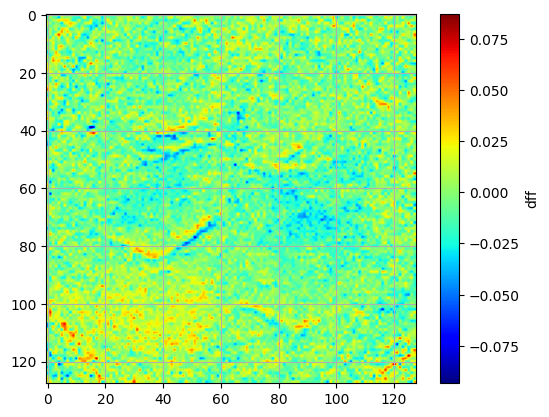

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:48,  2.61it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:43,  2.88it/s]

  2%|█▉                                                                                | 3/128 [00:01<00:43,  2.86it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:40,  3.03it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:39,  3.12it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:38,  3.15it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.18it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:39,  3.04it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:39,  3.04it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.08it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:37,  3.16it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.20it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.15it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:36,  3.12it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:36,  3.11it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:37,  3.02it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:35,  3.11it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.15it/s]

 15%|████████████                                                                     | 19/128 [00:06<00:33,  3.26it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.27it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:31,  3.41it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:29,  3.55it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:30,  3.46it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:31,  3.28it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:30,  3.33it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:30,  3.33it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.25it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:31,  3.13it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:32,  3.09it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:31,  3.07it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:30,  3.16it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:32,  2.97it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:31,  2.99it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:30,  3.07it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:30,  3.07it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:31,  2.93it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:29,  3.05it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:28,  3.13it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:29,  2.97it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:29,  2.98it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:30,  2.82it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:30,  2.78it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:29,  2.86it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:29,  2.89it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:27,  2.99it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:26,  3.12it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:15<00:25,  3.16it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:25,  3.14it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:25,  3.09it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:16<00:25,  3.11it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:24,  3.19it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:23,  3.29it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:17<00:22,  3.29it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:22,  3.24it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:23,  3.16it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.16it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:21,  3.28it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.22it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.18it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:20,  3.25it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:21,  3.17it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.20it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:20<00:20,  3.24it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.10it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:20,  3.09it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:21<00:20,  2.96it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:20,  2.96it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:19,  3.11it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:22<00:18,  3.18it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:22<00:17,  3.23it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:17,  3.21it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:23<00:18,  3.06it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:23<00:17,  3.08it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:17,  3.10it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:24<00:16,  3.14it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:24<00:16,  3.15it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:17,  2.99it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:25<00:16,  3.03it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:25<00:15,  3.13it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:15,  3.03it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:26<00:15,  3.10it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:26<00:14,  3.17it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:26<00:14,  3.17it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.24it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:27<00:12,  3.39it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:27<00:12,  3.28it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.32it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:28<00:12,  3.20it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:28<00:12,  3.21it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.25it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:29<00:11,  3.26it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:29<00:11,  3.16it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:11,  3.06it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:30<00:10,  3.14it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:30<00:10,  3.17it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:30<00:10,  3.20it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.20it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:31<00:09,  3.24it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:31<00:09,  3.21it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.14it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:32<00:08,  3.11it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:32<00:08,  3.18it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.27it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:33<00:07,  3.16it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:33<00:07,  3.18it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:33<00:06,  3.29it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:34<00:06,  3.15it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:34<00:06,  3.23it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:05,  3.26it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:35<00:05,  3.17it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:35<00:05,  3.19it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:35<00:05,  3.07it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:36<00:04,  3.08it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:36<00:04,  3.01it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:36<00:04,  3.11it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:37<00:03,  3.06it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:37<00:03,  3.16it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:37<00:03,  3.11it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.21it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:38<00:02,  3.00it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:38<00:02,  3.15it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:38<00:01,  3.20it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:39<00:01,  3.24it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:39<00:01,  3.15it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:39<00:00,  3.19it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:40<00:00,  3.23it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:40<00:00,  3.30it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.30it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.14it/s]

frame number 200 plotted


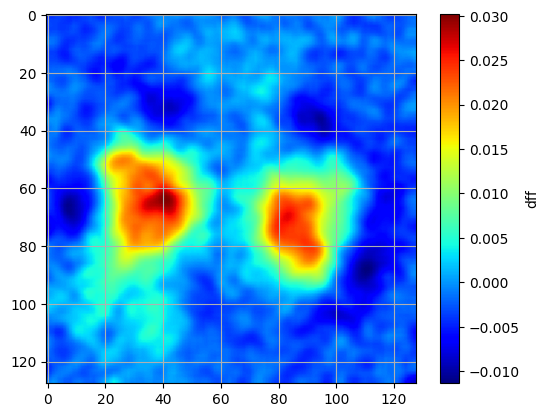

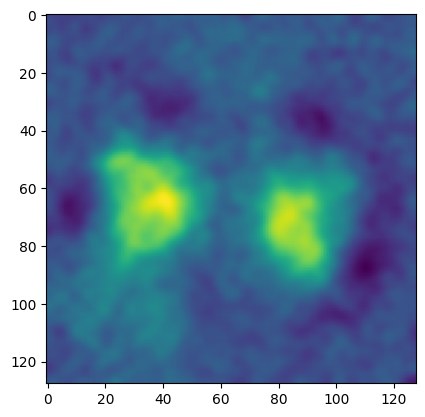

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 17


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 28
fail = 5
total trials = 33


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 18
fail = 32
total trials = 50


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 9
fail = 8
total trials = 17


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34870 [00:00<?, ?it/s]

  6%|████▋                                                                     | 2191/34870 [00:00<00:01, 21700.58it/s]

 13%|█████████▉                                                                | 4692/34870 [00:00<00:01, 23506.59it/s]

 20%|███████████████                                                           | 7083/34870 [00:00<00:01, 23586.47it/s]

 28%|█████████████████████                                                     | 9912/34870 [00:00<00:00, 25336.50it/s]

 36%|██████████████████████████                                               | 12446/34870 [00:00<00:01, 20795.55it/s]

 42%|██████████████████████████████▋                                          | 14684/34870 [00:00<00:00, 21203.83it/s]

 48%|███████████████████████████████████▎                                     | 16882/34870 [00:00<00:00, 21309.74it/s]

 55%|███████████████████████████████████████▉                                 | 19066/34870 [00:00<00:00, 20382.18it/s]

 62%|█████████████████████████████████████████████▎                           | 21640/34870 [00:00<00:00, 21857.77it/s]

 70%|██████████████████████████████████████████████████▋                      | 24238/34870 [00:01<00:00, 22988.86it/s]

 76%|███████████████████████████████████████████████████████▋                 | 26571/34870 [00:01<00:00, 22758.36it/s]

 83%|████████████████████████████████████████████████████████████▍            | 28871/34870 [00:01<00:00, 22059.30it/s]

 90%|█████████████████████████████████████████████████████████████████▊       | 31458/34870 [00:01<00:00, 23089.05it/s]

 97%|██████████████████████████████████████████████████████████████████████▋  | 33785/34870 [00:01<00:00, 22428.04it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34870/34870 [00:01<00:00, 22317.31it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 28580.31it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25007.77it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")